In [102]:
import os
import sys
import geopandas as gpd
import pandas as pd
from scipy.stats import pearsonr, spearmanr
from sklearn.feature_selection import mutual_info_regression
import numpy as np
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import altair as alt
from mpl_toolkits.mplot3d import Axes3D
alt.data_transformers.enable("vegafusion")
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
import warnings

warnings.filterwarnings('ignore')

In [3]:
sys.path.append("../../src")

In [4]:
import main

In [6]:
i = 200

In [7]:
gdf = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(i) + '.parquet')

In [14]:
gdf['Werthmann'] = gdf['Absolute_temperature_degC'] - gdf['Temperature_diff_K']

In [18]:
gdf['Time_UTC'] = pd.to_datetime(gdf['Time_UTC'])

BuAre_sum
50
200
1000


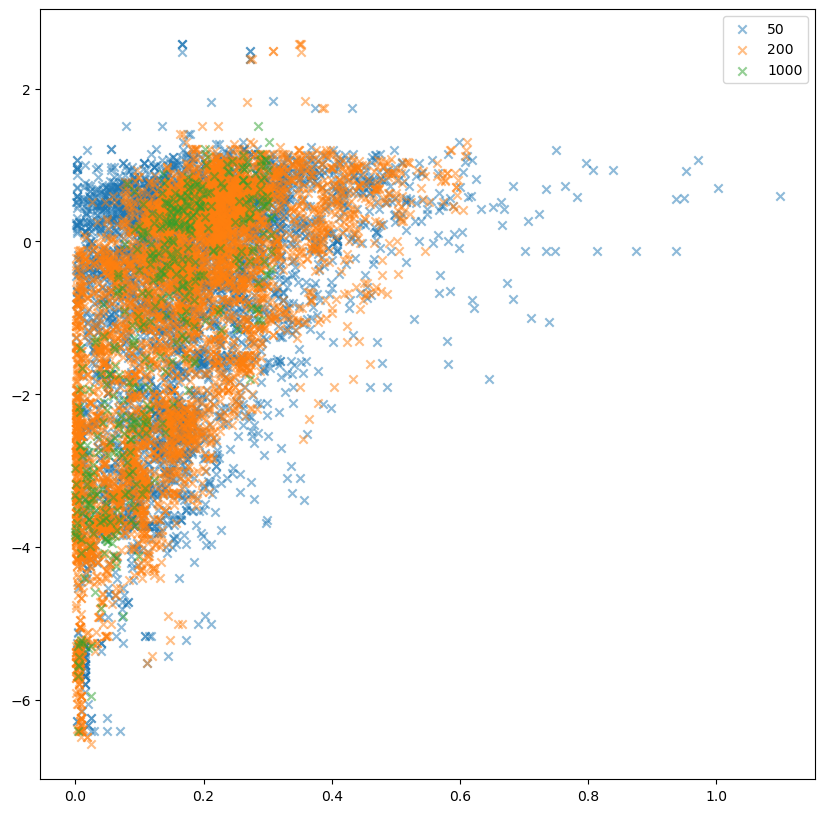

BuVol_3D_sum
50
200
1000


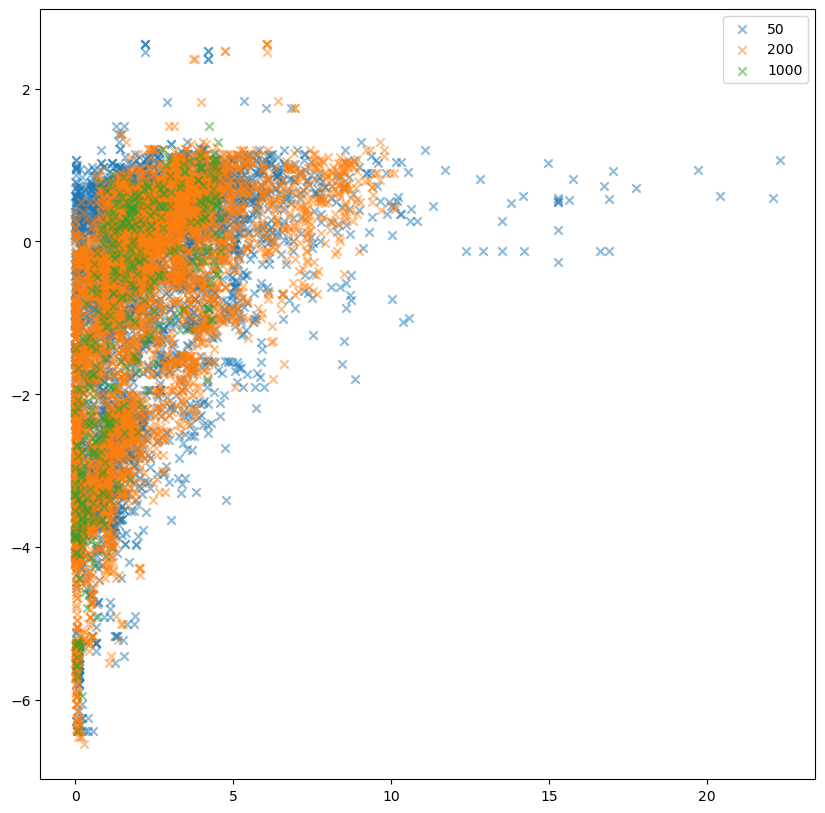

BuEWA_3D_sum
50
200
1000


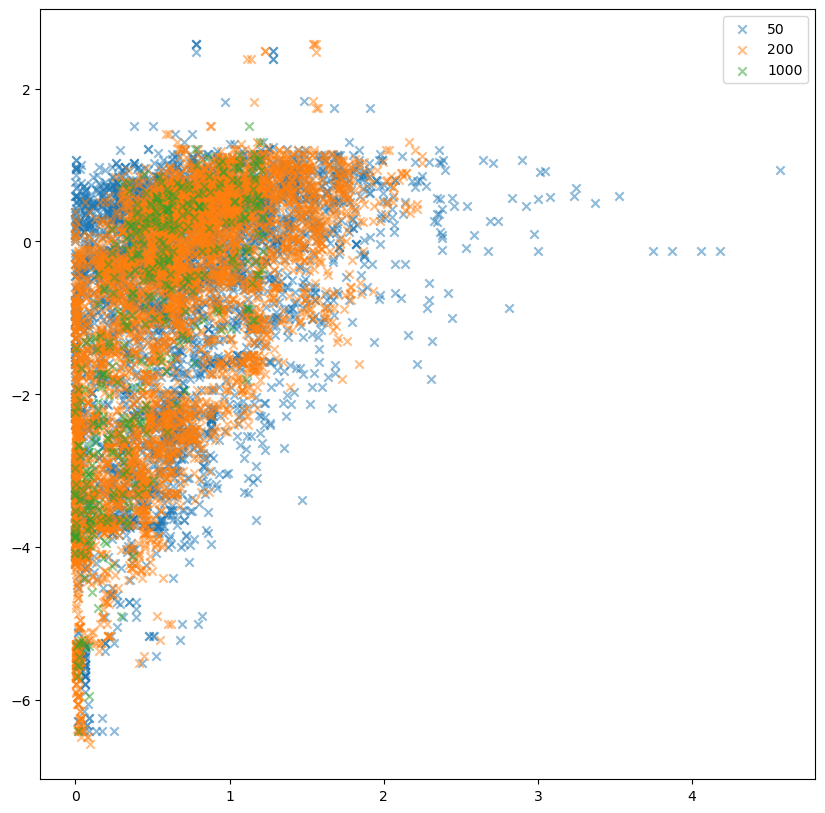

BuIBD
50
200
1000


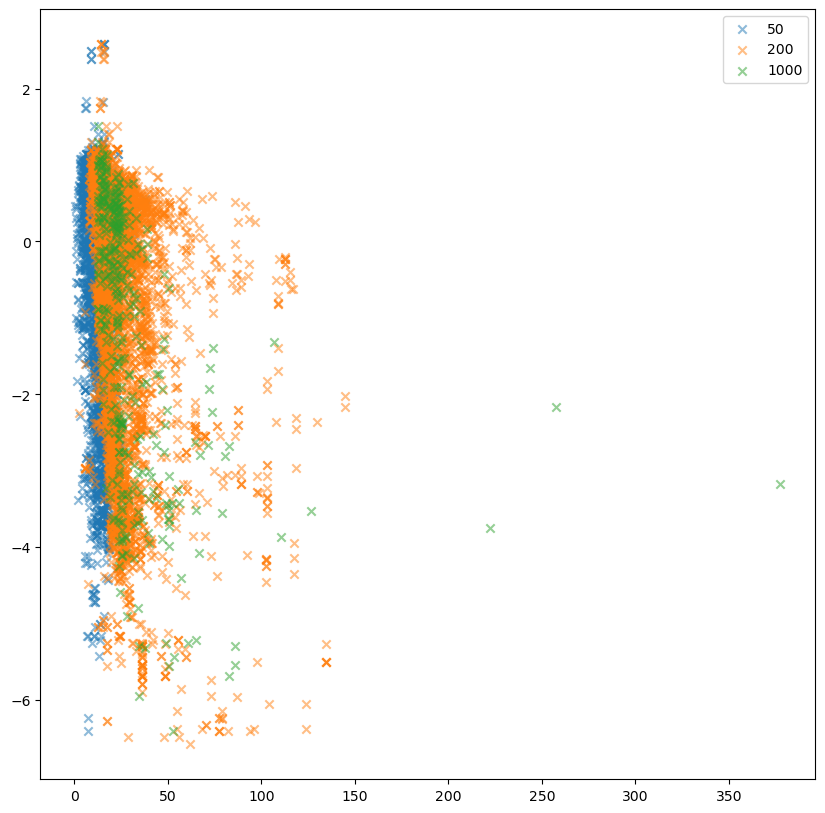

BuAdj
50
200
1000


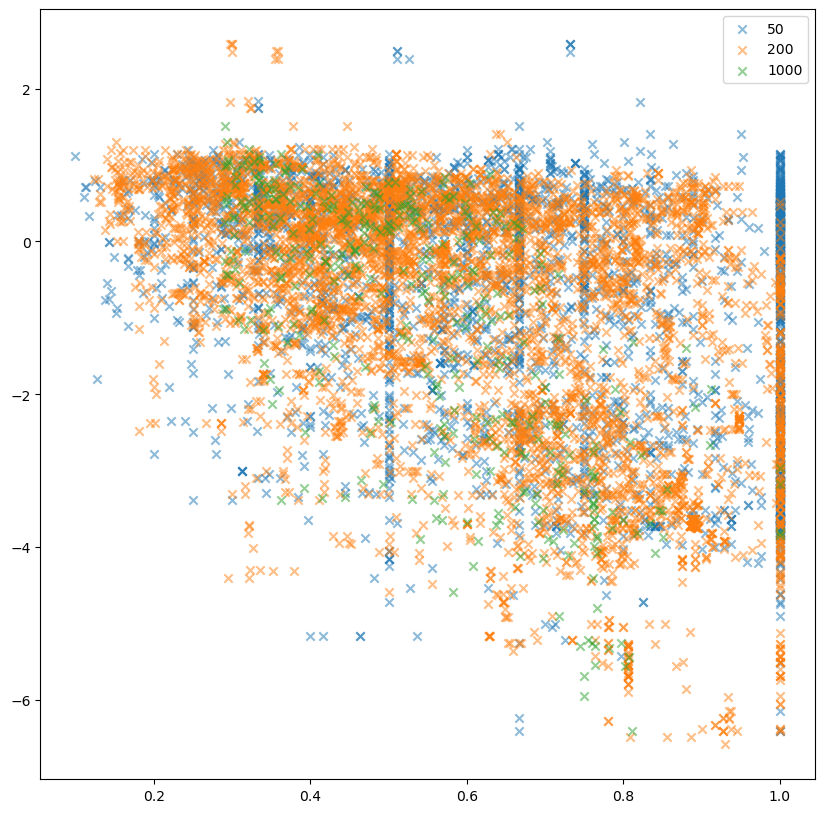

BuSWR_3D_median
50
200
1000


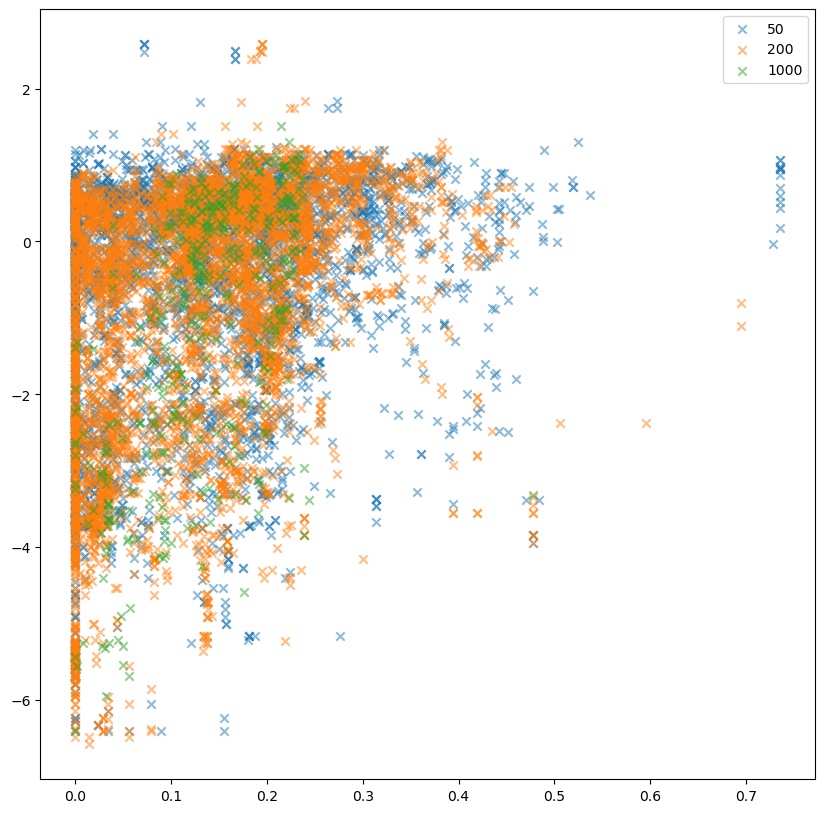

BuHt_wmean
50
200
1000


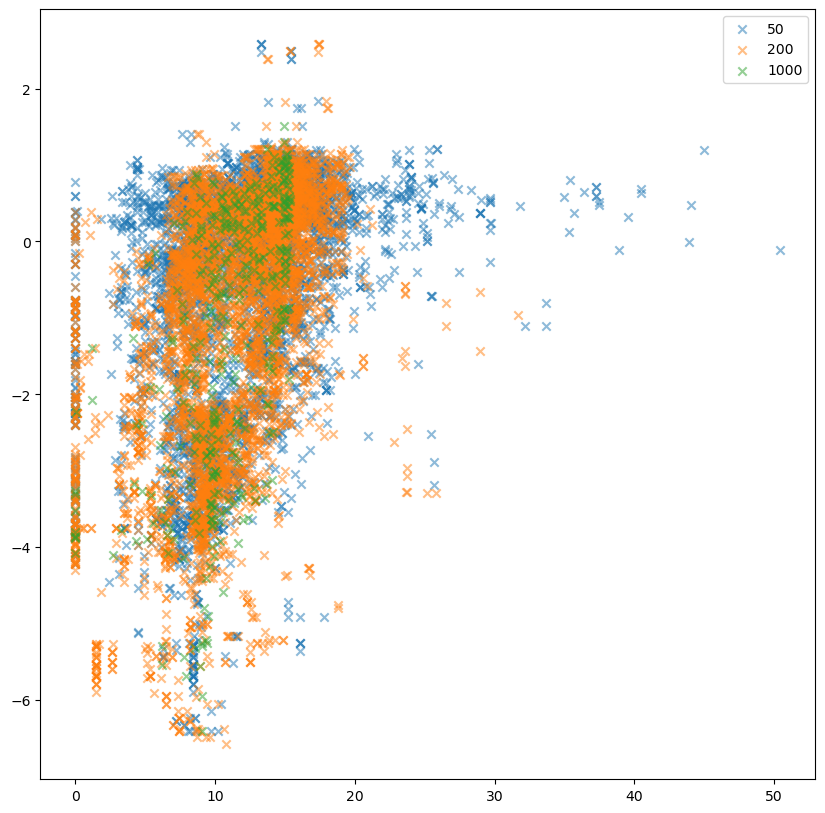

StrHW_median
50
200
1000


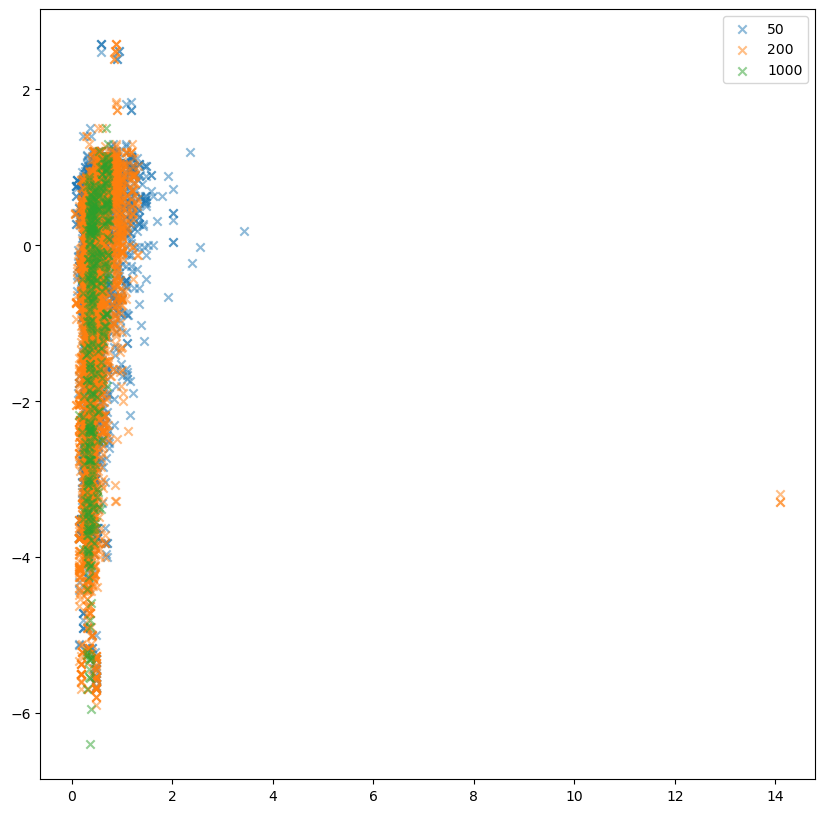

SVF_3D_mean
50
200
1000


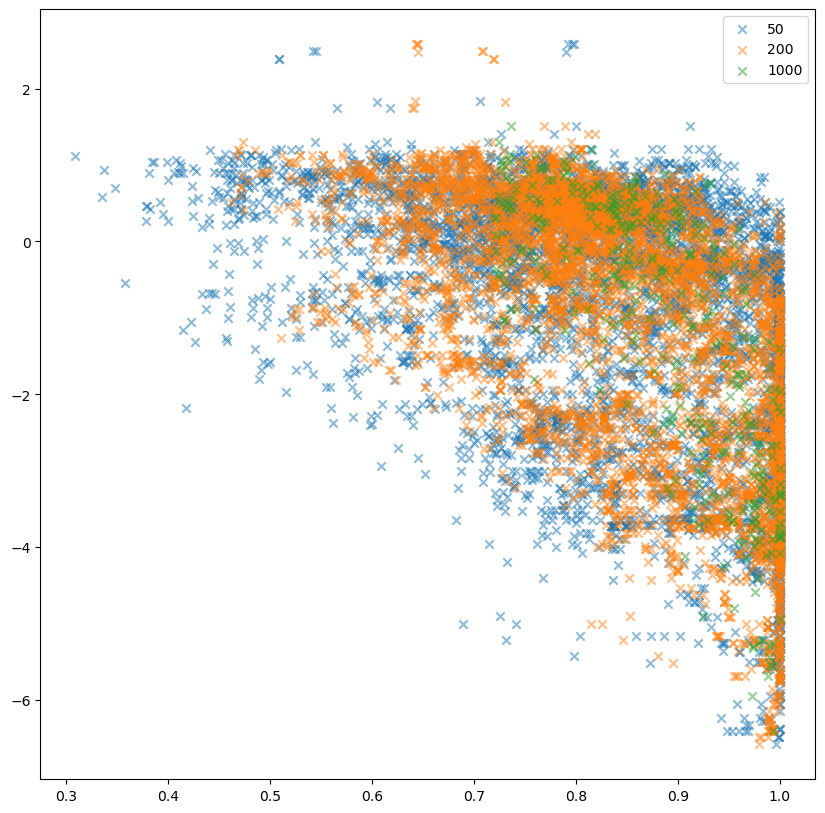

BuSqC_wmean
50
200
1000


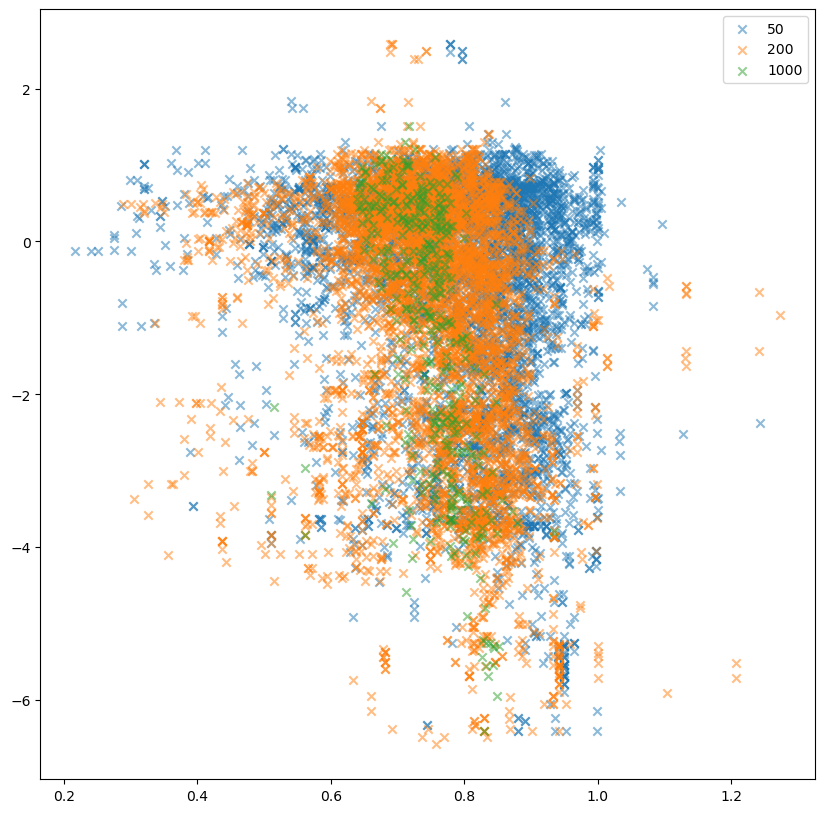

BuFra_3D_wmean
50
200
1000


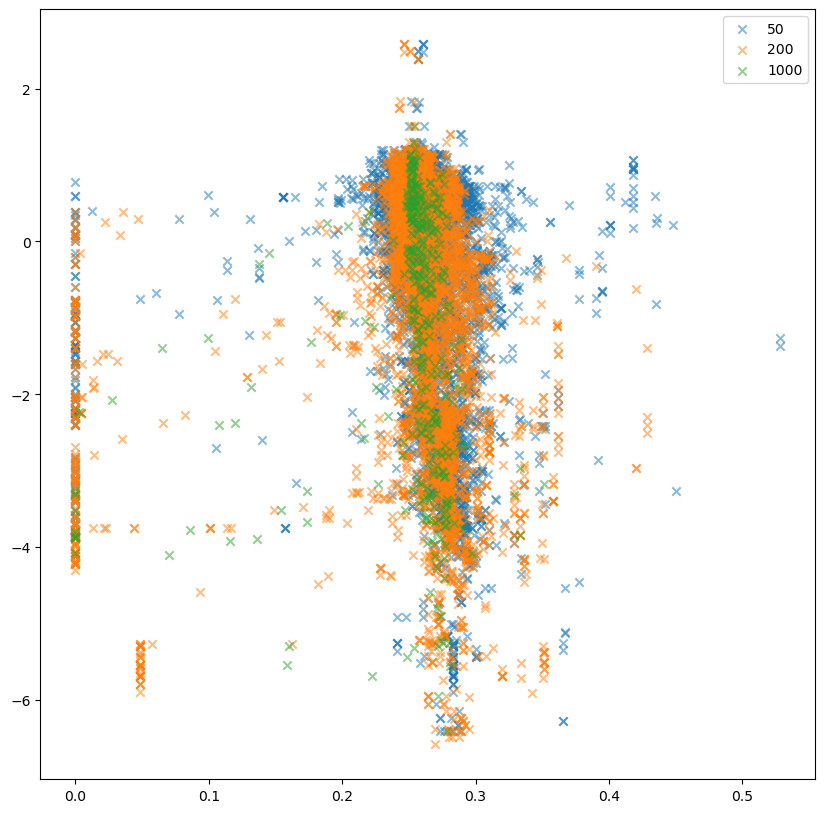

StrClo400_median
50
200
1000


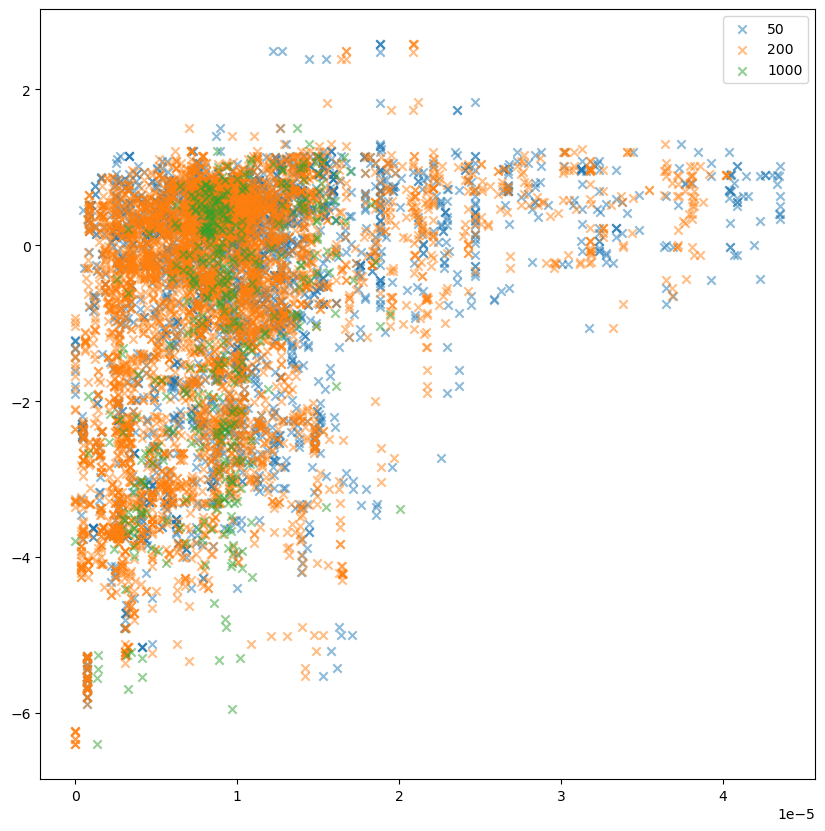

In [136]:
radii = [50,200,1000]
for param in params:
    print(param)
    plt.figure(figsize=(10,10))
    for radius in radii:
        print(radius)
        stn_buffers = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
        if param in ['BuAre_sum', 'BuVol_3D_sum','BuEWA_3D_sum']:
            plt.scatter(stn_buffers[param]/stn_buffers.geometry.area, stn_buffers['Temperature_diff_K'], label=radius, alpha=0.5, marker='x')
        else:
            plt.scatter(stn_buffers[param], stn_buffers['Temperature_diff_K'], label=radius, alpha=0.5, marker='x')
    plt.legend()
    plt.show()


50
200
1000


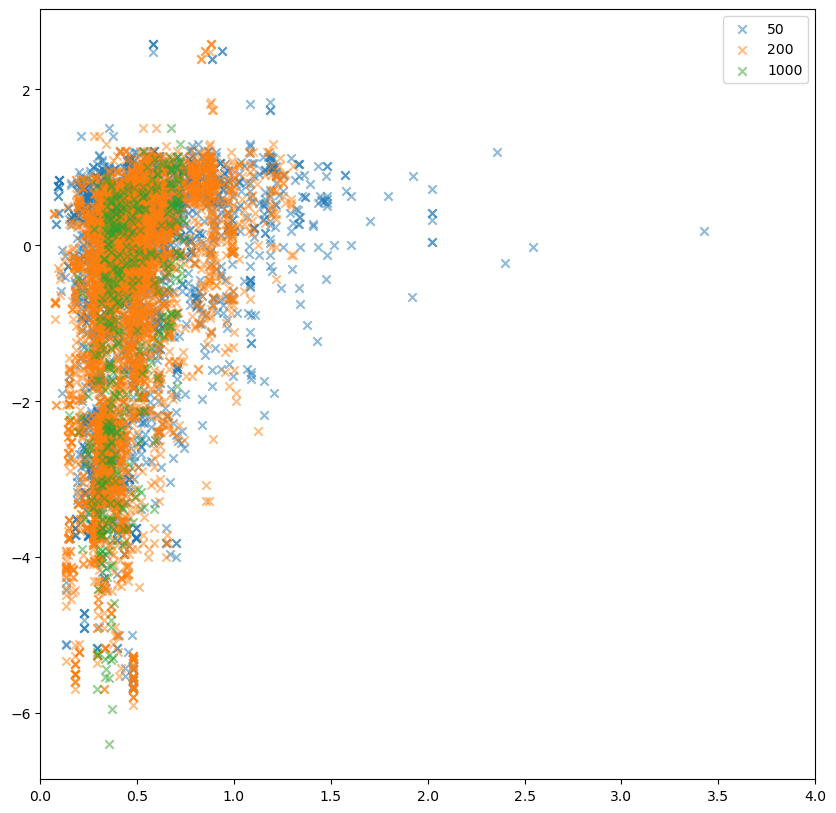

In [126]:
radii = [50,200,1000]

plt.figure(figsize=(10,10))
for radius in radii:
    print(radius)
    stn_buffers = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
    plt.scatter(stn_buffers['StrHW_median'], stn_buffers['Temperature_diff_K'], label=radius, alpha=0.5, marker='x')
    plt.xlim(0,4)
plt.legend()
plt.show()

50
100
200
300
320
500


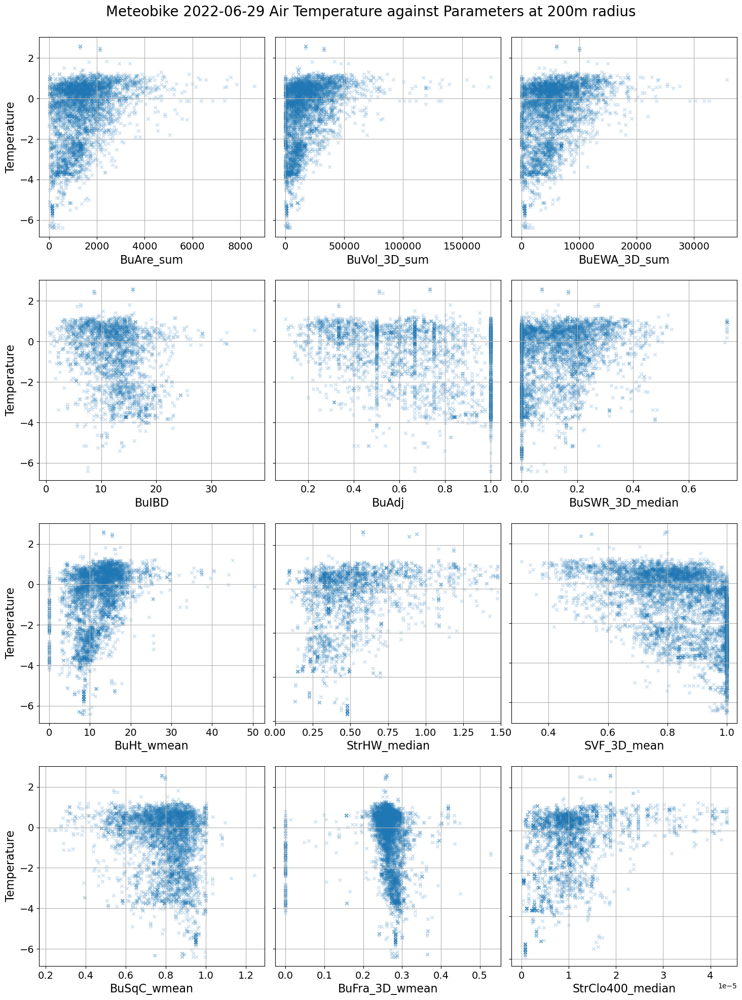

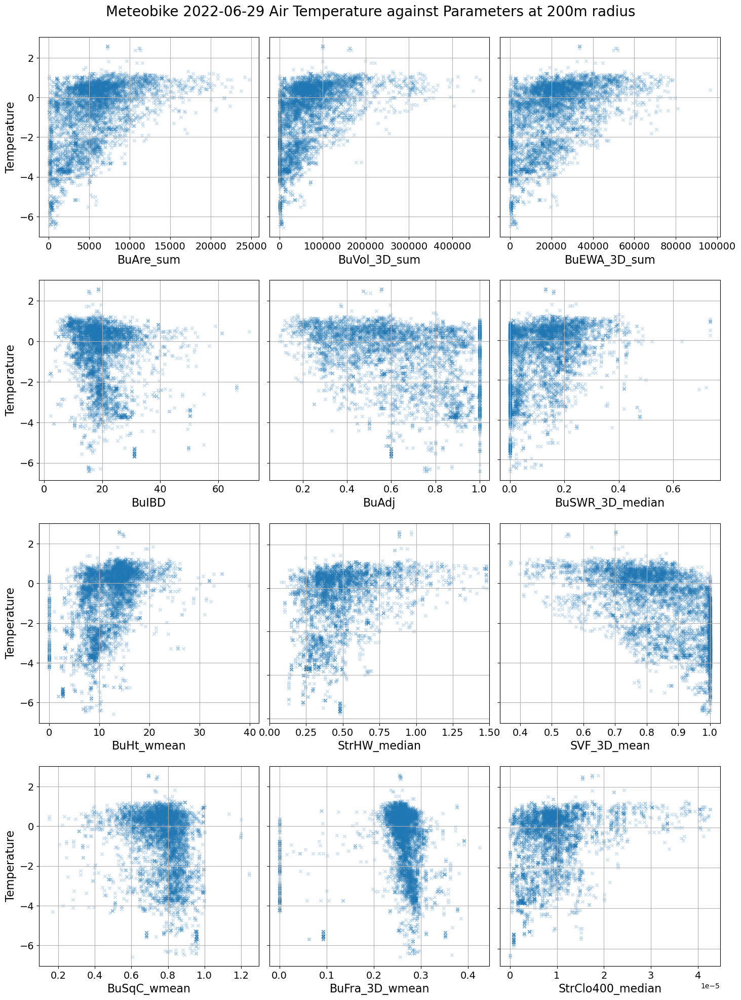

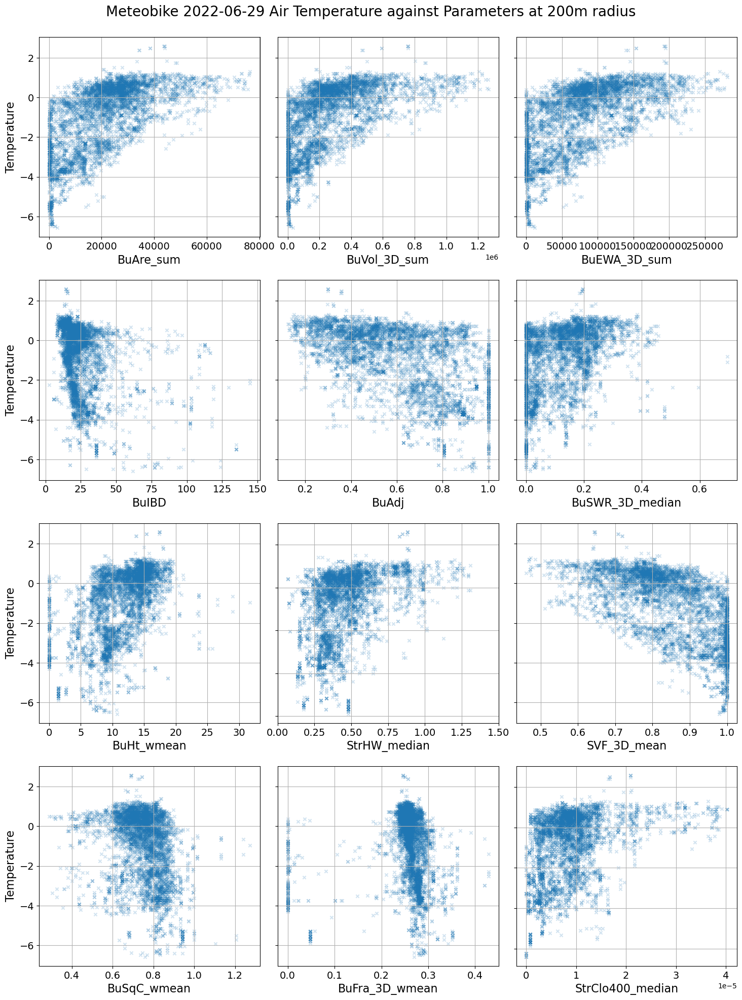

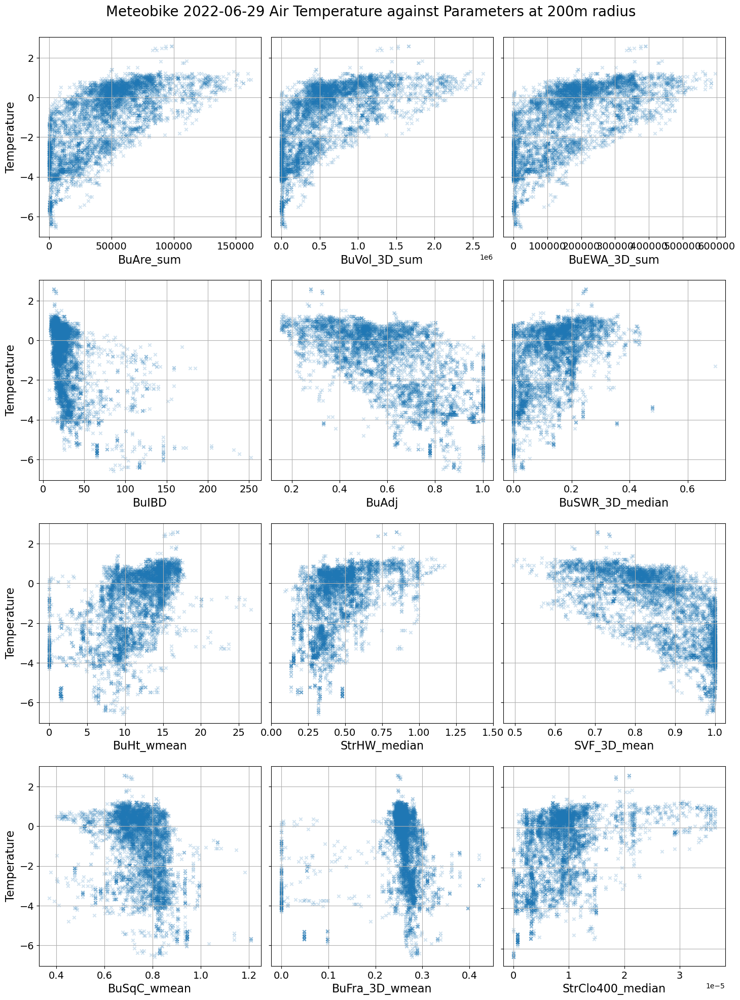

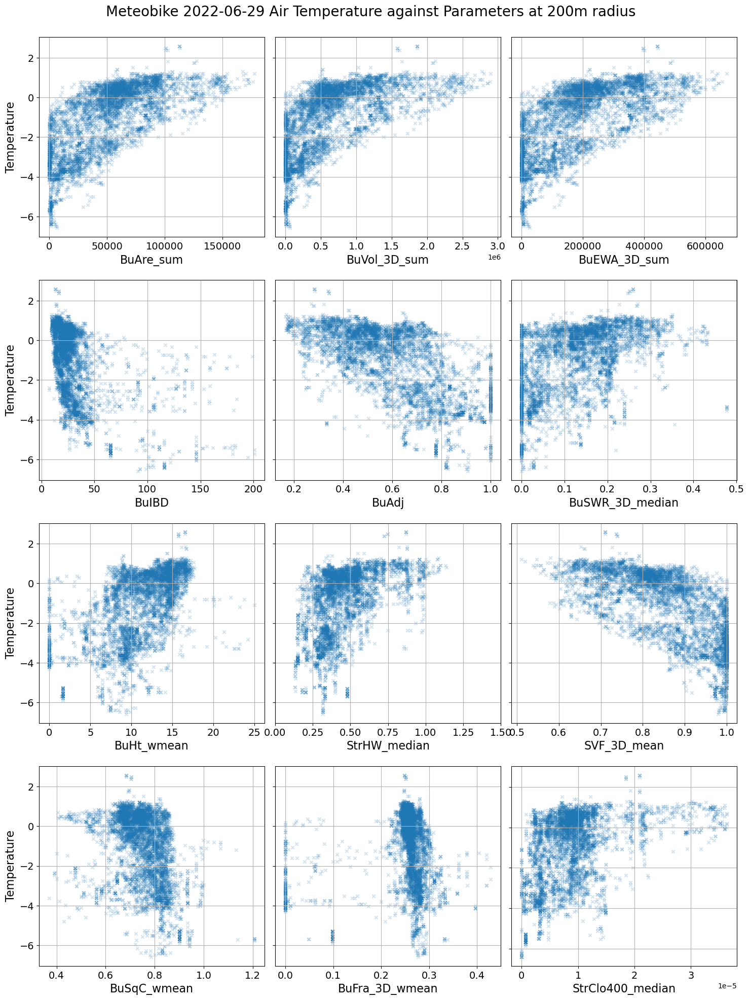

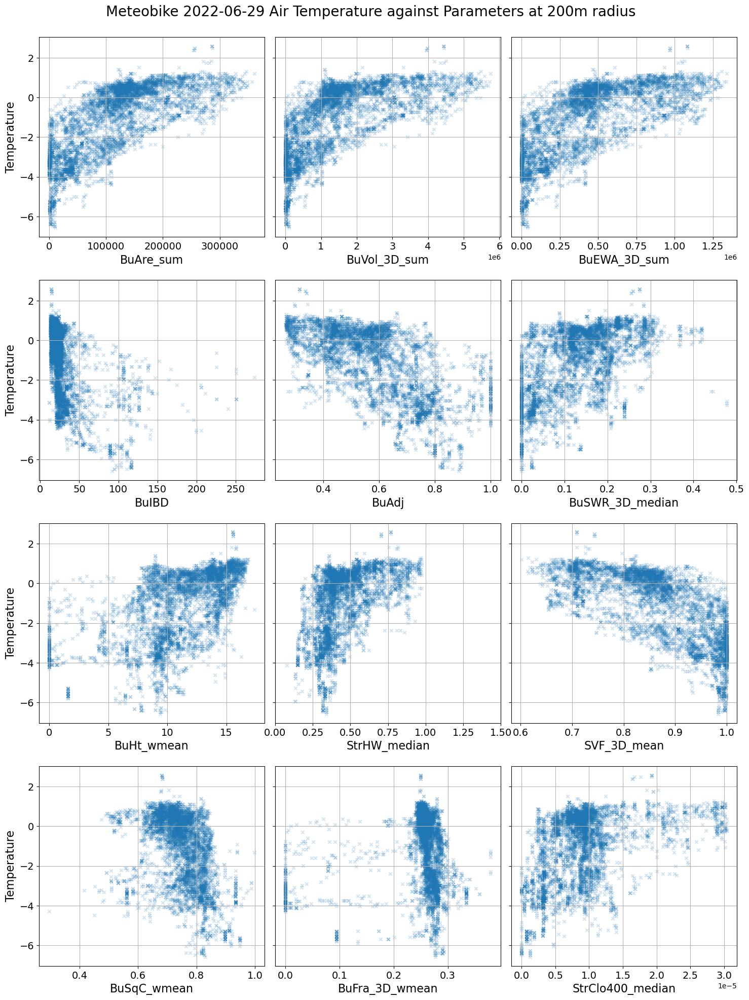

In [94]:
radii = [50,100,200,300,320,500]

spearman_corr = {}

for radius in radii:
    print(radius)
    stn_buffers = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
    spearman_corr[radius] = {}

    fig, axs = plt.subplots(4, 3, figsize=(15, 20))
    fig.suptitle('Meteobike 2022-06-29 Air Temperature against Parameters at 200m radius', fontsize=20, y=0.99)
    #fig.subplots_adjust(wspace=0.1)
    for i, ax in enumerate(axs.flat):
        if params[i] == 'StrHW_median':
            stn_buffers[['StrHW_median','Temperature_diff_K']].plot(x='StrHW_median', y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',xlim=(0,1.5),alpha=0.2)
        else:
            stn_buffers[[params[i],'Temperature_diff_K']].plot(x=params[i], y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',alpha=0.2)
        ax.tick_params(axis='both', which='major', labelsize=14)
        ax.set_xlabel(params[i],fontsize=16)
        ax.set_ylabel('Temperature',fontsize=16)
        ax.grid()

        if i % 3 != 0:  # 1st column (index 0, 3, 6, ...) keeps labels
            ax.set_ylabel("")  # Remove y-axis label
            ax.yaxis.set_ticklabels([])  # Remove y-axis ticks
            
    plt.tight_layout(pad = 2, w_pad=0.01)

In [118]:
# linear regression of ['BuAre_sum', 'BuVol_3D_sum', 'BuEWA_3D_sum', 'BuIBD', 'BuAdj', 'BuSWR_3D_median', 'BuHt_wmean','StrHW_median','SVF_3D_mean', 'BuSqC_wmean','BuFra_3D_wmean', 'StrClo400_median'] and 'Temperature_diff_K'

radii = [30,40,50,60,70,80,90,100,110,120,130,140,150,160,170,180,190,200,210,220,230,240,250,260,270,280,290,300,320,340,360,380,400,450,500,600,700,800,900,1000,1100,1200]

stats = {}

for radius in radii:
    print(radius)
    gdf = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
    stats[radius] = {}

    for var in ['BuAre_sum', 'BuVol_3D_sum', 'BuEWA_3D_sum', 'BuIBD', 'BuAdj', 'BuSWR_3D_median', 'BuHt_wmean','StrHW_median','SVF_3D_mean', 'BuSqC_wmean','BuFra_3D_wmean', 'StrClo400_median']:
        print(var)
        # drop nan values
        gdf_s = gdf.dropna(subset=[var, 'Temperature_diff_K'])

        if var in ['BuVol_3D_sum', 'BuEWA_3D_sum', 'BuSWR_3D_median', 'BuHt_wmean', 'BuFra_3D_wmean']:
            gdf_s = gdf_s[gdf_s[var] > 0]

        stats[radius][var+'_std'] = gdf_s[var].std()
        stats[radius][var+'_mean'] = gdf_s[var].mean()
        stats[radius][var+'_CV'] = gdf_s[var].std()/gdf_s[var].mean()

        stats[radius][var+'_spearman_corr'], stats[radius][var+'_spearman_p_value'] = spearmanr(gdf_s[var],gdf_s['Temperature_diff_K'])

        # Pearson and r squared
        stats[radius][var+'_pearson_corr'], stats[radius][var+'_pearson_p_value'] = pearsonr(gdf_s[var], gdf_s['Temperature_diff_K'])
        X = sm.add_constant(gdf_s[var])  # Add constant for regression
        model = sm.OLS(gdf_s['Temperature_diff_K'], X).fit()
        r_squared = model.rsquared
        stats[radius][var+'_rsquared'] = r_squared

        # Get the predicted values (fitted values)
        y_pred = model.fittedvalues

        # Calculate the residuals (errors)
        residuals = gdf_s['Temperature_diff_K'] - y_pred

        # Calculate the least squares error (RSS)
        rss = np.sum(residuals ** 2)
        # Calculate the Mean Squared Error (MSE)
        mse = rss / len(gdf_s[var])
        # Calculate the Root Mean Squared Error (RMSE)
        rmse = np.sqrt(mse)
        stats[radius][var+'_rmse'] = rmse

        # Compute Cook's distance
        influence = model.get_influence()
        cooks_d = influence.cooks_distance[0].max()  # Max Cook's distance
        stats[radius][var+'_cooks_d'] = cooks_d


30
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
40
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
50
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
60
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
70
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
80
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuFra_3D_wmean
StrClo400_median
90
BuAre_sum
BuVol_3D_sum
BuEWA_3D_sum
BuIBD
BuAdj
BuSWR_3D_median
BuHt_wmean
StrHW_median
SVF_3D_mean
BuSqC_wmean
BuF

In [119]:
pd.DataFrame(stats).T.to_csv('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_stats_scales.csv')

In [120]:
df = pd.DataFrame(stats).T

In [122]:
params = ['BuAre_sum', 'BuVol_3D_sum', 'BuEWA_3D_sum', 'BuIBD', 'BuAdj', 'BuSWR_3D_median', 'BuHt_wmean','StrHW_median','SVF_3D_mean', 'BuSqC_wmean','BuFra_3D_wmean', 'StrClo400_median']

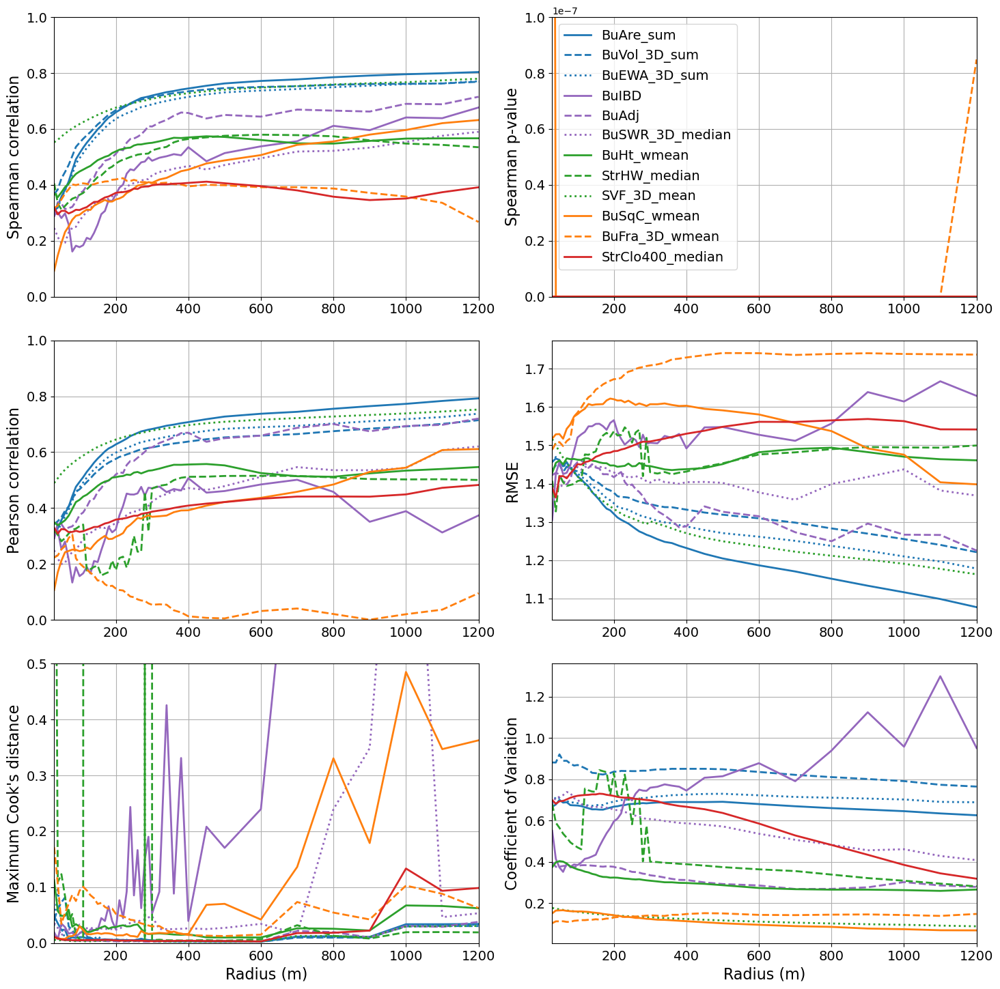

In [123]:
# make 4 subplots
fig, axs = plt.subplots(3,2, figsize=(15, 15))

linestyle_mapping = {
    'BuAre_sum': '-',
    'BuVol_3D_sum': '--',
    'BuEWA_3D_sum': ':',
    'BuIBD':'-',
    'BuAdj':'--',
    'BuSWR_3D_median':':',
    'BuHt_wmean': '-',
    'StrHW_median': '--',
    'SVF_3D_mean': ':',
    'BuSqC_wmean': '-',
    'BuFra_3D_wmean': '--',
    'StrClo400_median': '-'
}

color_mapping = {
    'BuAre_sum': 'tab:blue',
    'BuVol_3D_sum': 'tab:blue',
    'BuEWA_3D_sum': 'tab:blue',
    'BuIBD':'tab:purple',
    'BuAdj':'tab:purple',
    'BuSWR_3D_median':'tab:purple',
    'BuHt_wmean': 'tab:green',
    'StrHW_median': 'tab:green',
    'SVF_3D_mean': 'tab:green',
    'BuSqC_wmean': 'tab:orange',
    'BuFra_3D_wmean': 'tab:orange',
    'StrClo400_median': 'tab:red'
}

for var in params:
    axs[0, 0].plot(abs(df[var+'_spearman_corr']), label=var, linestyle=linestyle_mapping[var], linewidth=2, color=color_mapping[var])
axs[0, 0].set_ylabel('Spearman correlation', fontsize=16)
axs[0, 0].set_ylim(0, 1)
axs[0, 0].set_xlim(30, 1200)
#axs[0, 0].set_xticklabels([])
axs[0, 0].tick_params(axis='both', which='major', labelsize=14)
axs[0, 0].grid()

for var in params:
    axs[0, 1].plot(df[var+'_spearman_p_value'], label=var, linestyle=linestyle_mapping[var], linewidth=2, color=color_mapping[var])
axs[0, 1].set_ylabel("Spearman p-value", fontsize=16)
axs[0, 1].legend(prop={'size': 14})
axs[0, 1].set_ylim(0, 0.0000001)
axs[0, 1].set_xlim(30, 1200)
#axs[0, 1].set_xticklabels([])
axs[0, 1].tick_params(axis='both', which='major', labelsize=14)
axs[0, 1].grid()

for var in params:
    axs[1, 0].plot(abs(df[var+'_pearson_corr']), label=var, linestyle=linestyle_mapping[var], linewidth=2,color=color_mapping[var])
axs[1, 0].set_ylabel('Pearson correlation', fontsize=16)
axs[1, 0].set_ylim(0, 1)
axs[1, 0].set_xlim(30, 1200)
#axs[1, 0].set_xticklabels([])
axs[1, 0].tick_params(axis='both', which='major', labelsize=14)
axs[1, 0].grid()

for var in params:
    axs[1, 1].plot(df[var+'_rmse'], label=var, linestyle=linestyle_mapping[var],linewidth=2, color=color_mapping[var])
axs[1, 1].set_ylabel('RMSE', fontsize=16)
axs[1, 1].grid()
#axs[1, 1].set_ylim(0.5, 1.1)
axs[1, 1].set_xlim(30, 1200)
#axs[1, 1].set_xticklabels([])
axs[1, 1].tick_params(axis='both', which='major', labelsize=14)

for var in params:
    axs[2, 0].plot(df[var+'_cooks_d'], label=var, linestyle=linestyle_mapping[var],linewidth=2, color=color_mapping[var])
axs[2, 0].set_ylabel("Maximum Cook's distance", fontsize=16)
axs[2, 0].set_ylim(0, 0.5)
axs[2, 0].set_xlim(30, 1200)
axs[2, 0].set_xlabel('Radius (m)', fontsize=16)
axs[2, 0].tick_params(axis='both', which='major', labelsize=14)
axs[2, 0].grid()

for var in params:
    axs[2, 1].plot(df[var+'_CV'], label=var, linestyle=linestyle_mapping[var],linewidth=2, color=color_mapping[var])
axs[2, 1].set_ylabel("Coefficient of Variation", fontsize=16)
#axs[2, 1].set_ylim(0, 2)
axs[2, 1].set_xlim(30, 1200)
axs[2, 1].set_xlabel('Radius (m)', fontsize=16)
axs[2, 1].tick_params(axis='both', which='major', labelsize=14)
axs[2, 1].grid()

plt.tight_layout(pad = 2, w_pad=1)
plt.savefig('/Users/lisawink/Documents/paper1/figures/mbike270623_param_scale_plot_featured_list.png')
plt.savefig('/Users/lisawink/Documents/paper1/figures/mbike270623_param_scale_plot_featured_list.pdf')
plt.show()

In [137]:
from shapely.geometry import Point

In [145]:
# calculate distance from city centre
def city_centre_distance(stations, city_centre, input_crs='EPSG:4326', output_crs='EPSG:31468', lat_column = 'station_lat', lon_column = 'station_lon'):
    """city centre in input crs"""
    geometry = [Point(xy) for xy in zip(stations[lon_column], stations[lat_column])]
    stn_gdf = gpd.GeoDataFrame(stations, crs=input_crs, geometry=geometry)

    stn_gdf = stn_gdf.to_crs(output_crs)

    city_centre_gdf = gpd.GeoDataFrame({'geometry': [city_centre]}, crs=input_crs)
    city_centre = city_centre_gdf.to_crs(output_crs).geometry[0]
    stn_gdf['city_centre_distance'] = stn_gdf.distance(city_centre)
    return stn_gdf

In [146]:
mbike = pd.read_csv('/Users/lisawink/Documents/paper1/data/raw_data/ALL-SYSTEMS-2023-06-27.csv')
city_centre = Point(7.8439085,47.9976443)
mbike = city_centre_distance(mbike, city_centre, input_crs='EPSG:4326', output_crs='EPSG:31468', lat_column = 'Latitude', lon_column = 'Longitude')

In [148]:
radius = 200
stn_buffers = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
city_centre = Point(7.8439085,47.9976443)
stn_buffers = city_centre_distance(stn_buffers, city_centre, input_crs='EPSG:4326', output_crs='EPSG:31468', lat_column = 'Latitude', lon_column = 'Longitude')

BuAre_sum


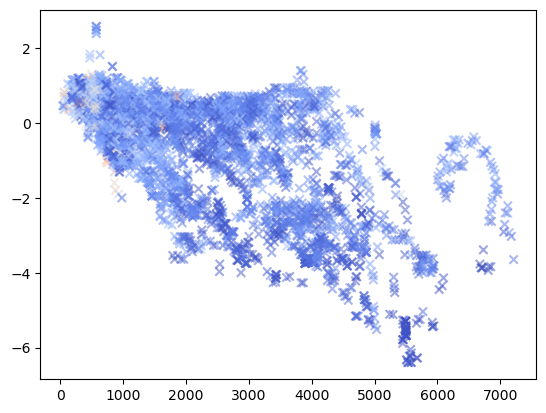

BuVol_3D_sum


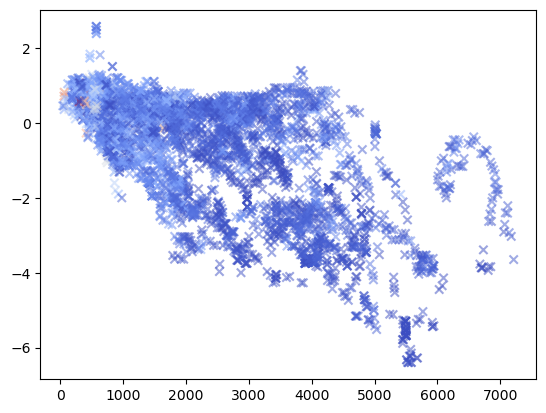

BuEWA_3D_sum


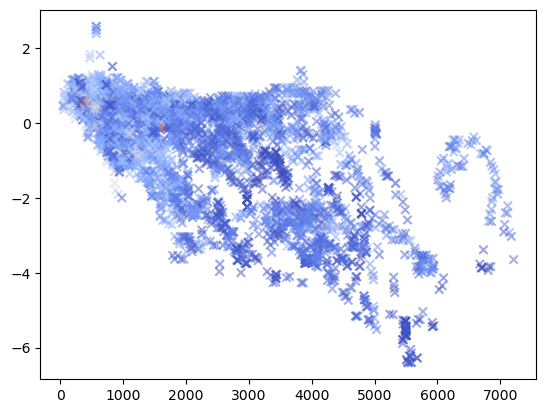

BuIBD


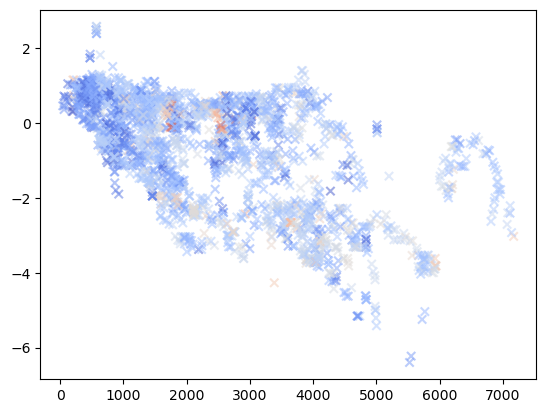

BuAdj


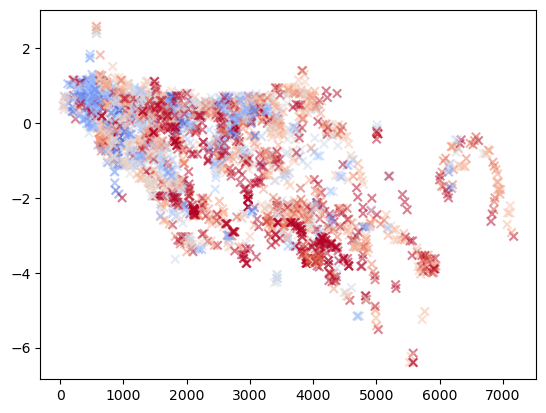

BuSWR_3D_median


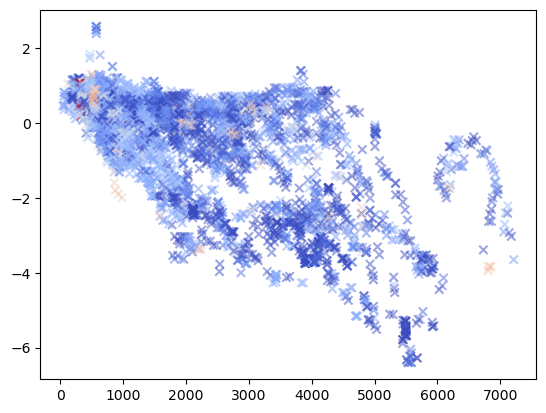

BuHt_wmean


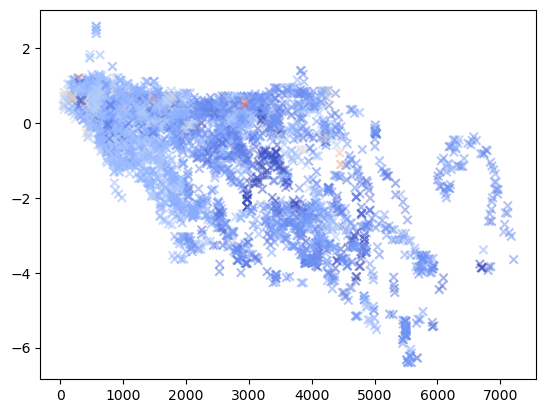

StrHW_median


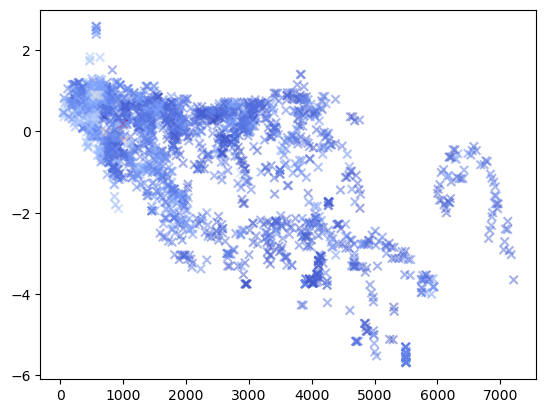

SVF_3D_mean


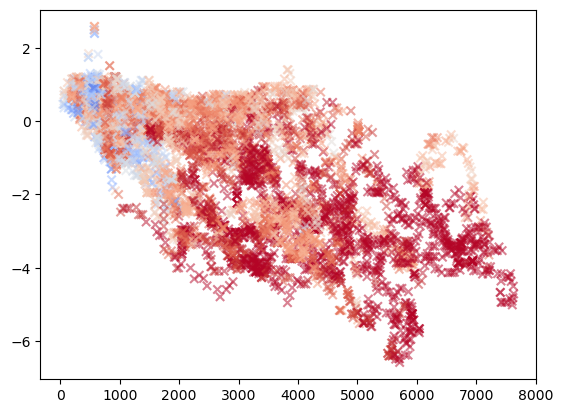

BuSqC_wmean


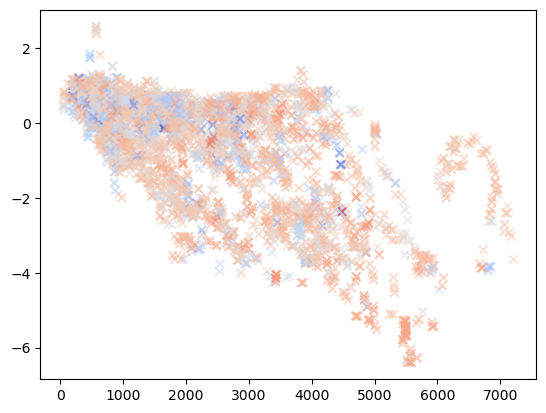

BuFra_3D_wmean


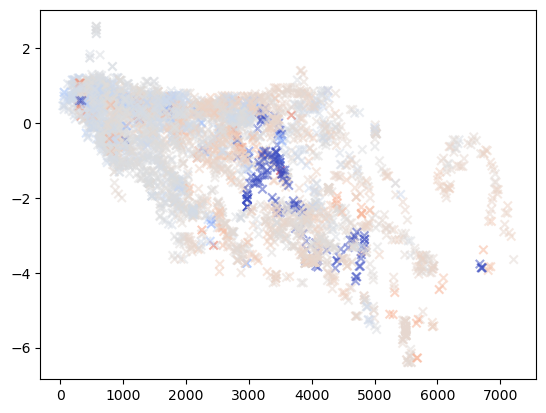

StrClo400_median


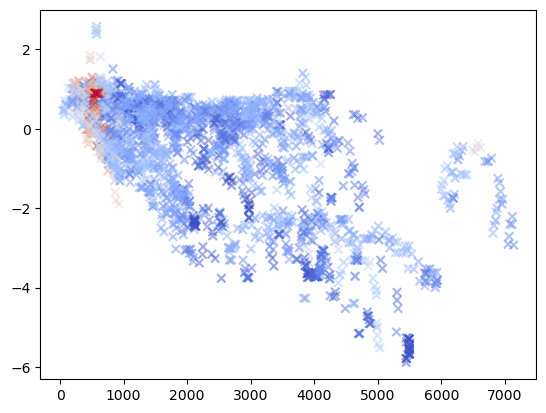

In [181]:
for param in params:
    print(param)
    plt.scatter(stn_buffers['city_centre_distance'], stn_buffers['Temperature_diff_K'], alpha=0.5, marker='x', c=stn_buffers[param],cmap='coolwarm')
    plt.show()

In [161]:
spearmanr(stn_buffers['city_centre_distance'], stn_buffers['Temperature_diff_K'])

SignificanceResult(statistic=-0.7068497577104637, pvalue=0.0)

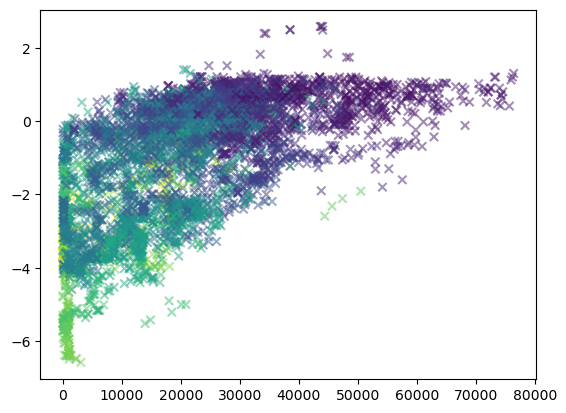

In [151]:
plt.scatter(stn_buffers['BuAre_sum'], stn_buffers['Temperature_diff_K'], alpha=0.5, marker='x',c=stn_buffers['city_centre_distance'])

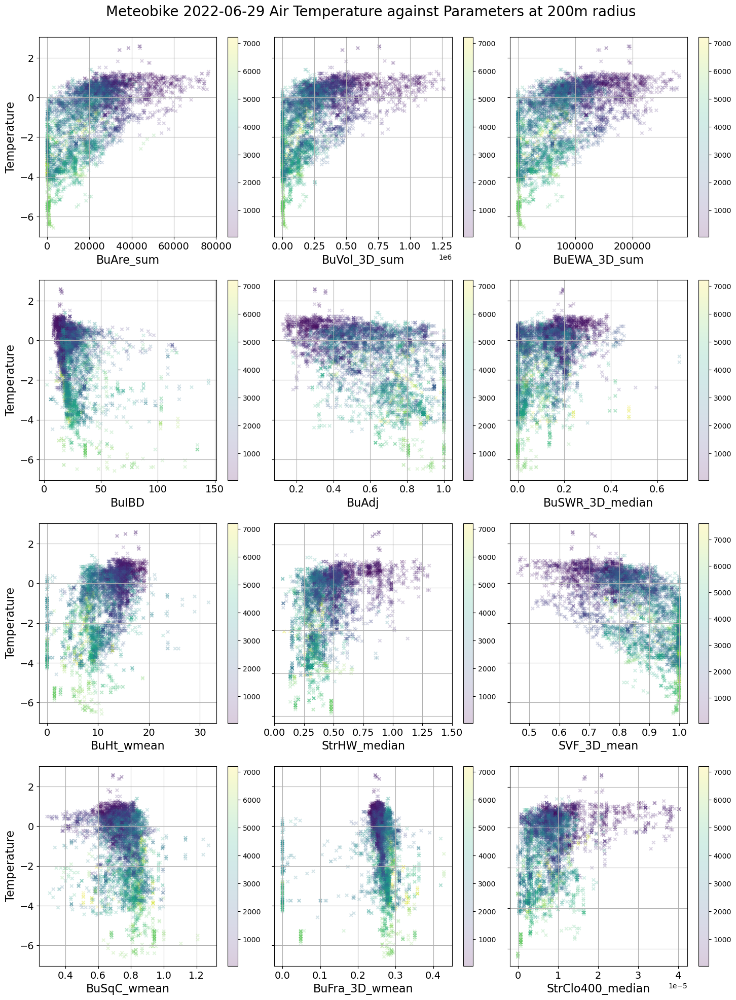

In [159]:
fig, axs = plt.subplots(4, 3, figsize=(15, 20))
fig.suptitle('Meteobike 2022-06-29 Air Temperature against Parameters at 200m radius', fontsize=20, y=0.99)
#fig.subplots_adjust(wspace=0.1)
for i, ax in enumerate(axs.flat):
    if params[i] == 'StrHW_median':
        p = stn_buffers[['StrHW_median','Temperature_diff_K']].plot(x='StrHW_median', y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',xlim=(0,1.5),alpha=0.2,c=stn_buffers['city_centre_distance'],cmap='viridis')
    else:
        p = stn_buffers[[params[i],'Temperature_diff_K']].plot(x=params[i], y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',alpha=0.2,c=stn_buffers['city_centre_distance'],cmap='viridis')
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel(params[i],fontsize=16)
    ax.set_ylabel('Temperature',fontsize=16)
    ax.grid()
    

    if i % 3 != 0:  # 1st column (index 0, 3, 6, ...) keeps labels
        ax.set_ylabel("")  # Remove y-axis label
        ax.yaxis.set_ticklabels([])  # Remove y-axis ticks
#plt.colorbar(  p, orientation='horizontal', label='Distance to city centre (m)')
plt.tight_layout(pad = 2, w_pad=0.01)

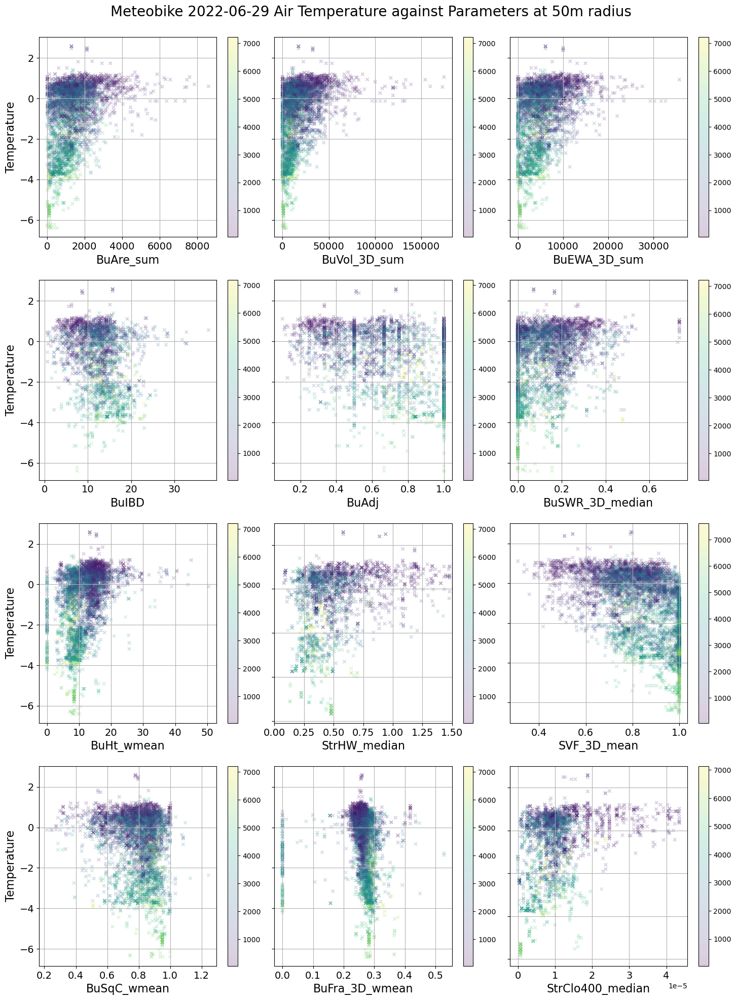

In [160]:
radius = 50
stn_buffers = gpd.read_parquet('/Users/lisawink/Documents/paper1/data/processed_data/mbike/270623_processed_station_params_' + str(radius) + '.parquet')
city_centre = Point(7.8439085,47.9976443)
stn_buffers = city_centre_distance(stn_buffers, city_centre, input_crs='EPSG:4326', output_crs='EPSG:31468', lat_column = 'Latitude', lon_column = 'Longitude')

fig, axs = plt.subplots(4, 3, figsize=(15, 20))
fig.suptitle('Meteobike 2022-06-29 Air Temperature against Parameters at 50m radius', fontsize=20, y=0.99)
#fig.subplots_adjust(wspace=0.1)
for i, ax in enumerate(axs.flat):
    if params[i] == 'StrHW_median':
        p = stn_buffers[['StrHW_median','Temperature_diff_K']].plot(x='StrHW_median', y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',xlim=(0,1.5),alpha=0.2,c=stn_buffers['city_centre_distance'],cmap='viridis')
    else:
        p = stn_buffers[[params[i],'Temperature_diff_K']].plot(x=params[i], y='Temperature_diff_K', ax=ax, kind='scatter',marker='x',alpha=0.2,c=stn_buffers['city_centre_distance'],cmap='viridis')
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel(params[i],fontsize=16)
    ax.set_ylabel('Temperature',fontsize=16)
    ax.grid()
    

    if i % 3 != 0:  # 1st column (index 0, 3, 6, ...) keeps labels
        ax.set_ylabel("")  # Remove y-axis label
        ax.yaxis.set_ticklabels([])  # Remove y-axis ticks
#plt.colorbar(  p, orientation='horizontal', label='Distance to city centre (m)')
plt.tight_layout(pad = 2, w_pad=0.01)

In [ ]:
# colour by local climate zone?

In [165]:
params

['BuAre_sum',
 'BuVol_3D_sum',
 'BuEWA_3D_sum',
 'BuIBD',
 'BuAdj',
 'BuSWR_3D_median',
 'BuHt_wmean',
 'StrHW_median',
 'SVF_3D_mean',
 'BuSqC_wmean',
 'BuFra_3D_wmean',
 'StrClo400_median']

In [259]:
# PCA with main params and city centre distance
data = stn_buffers[params+['city_centre_distance','Temperature_diff_K','geometry']].dropna()

In [260]:
data

,BuAre_sum,BuVol_3D_sum,BuEWA_3D_sum,BuIBD,BuAdj,BuSWR_3D_median,BuHt_wmean,StrHW_median,SVF_3D_mean,BuSqC_wmean,BuFra_3D_wmean,StrClo400_median,city_centre_distance,Temperature_diff_K,geometry
0,2045.137502,27573.514160,9535.040396,15.489008,0.801020,0.088512,13.522859,1.084105,0.614575,0.834154,0.258958,0.000019,623.768885,1.30,POINT (4190036.817 5325468.375)
2,1434.517025,20644.486074,7186.388115,14.259553,0.706667,0.163917,14.433956,0.457891,0.772123,0.700344,0.264519,0.000015,734.668396,1.02,POINT (4190032.428 5325356.571)
3,1196.349353,17946.472724,5959.129088,14.259553,0.706667,0.180731,15.045517,0.457891,0.781607,0.717530,0.263292,0.000015,737.820225,1.02,POINT (4190033.535 5325353.501)
6,2627.900383,43797.002203,8722.270451,12.887429,0.600000,0.240001,16.715994,0.578977,0.617399,0.860527,0.239288,0.000010,879.289077,0.81,POINT (4189874.872 5325214.686)
7,2052.922158,28179.773482,8662.014642,10.858990,0.530032,0.303973,13.767789,0.672167,0.668126,0.845252,0.270161,0.000006,927.859016,0.82,POINT (4189835.829 5325170.751)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5936,1956.055714,27779.508752,8765.103093,14.274976,0.835714,0.137593,14.244175,0.484346,0.601913,0.853686,0.253036,0.000019,649.430093,-0.75,POINT (4190049.871 5325444.036)
5937,2250.276178,32075.815949,10226.520380,13.859627,0.806122,0.130471,14.296700,1.084105,0.605865,0.868644,0.253879,0.000019,640.404053,-0.54,POINT (4190050.139 5325453.163)
5938,1816.300415,26003.079868,8465.846513,14.445443,0.780612,0.134236,14.359229,1.084105,0.624714,0.879611,0.256419,0.000019,626.003491,-0.44,POINT (4190050.024 5325467.662)
5939,1720.557210,23596.315115,8064.489737,14.445443,0.780612,0.126705,13.755436,1.084105,0.637627,0.850390,0.259638,0.000019,616.909386,-0.44,POINT (4190046.152 5325476.344)


Text(0, 0.5, 'cumulative explained variance')

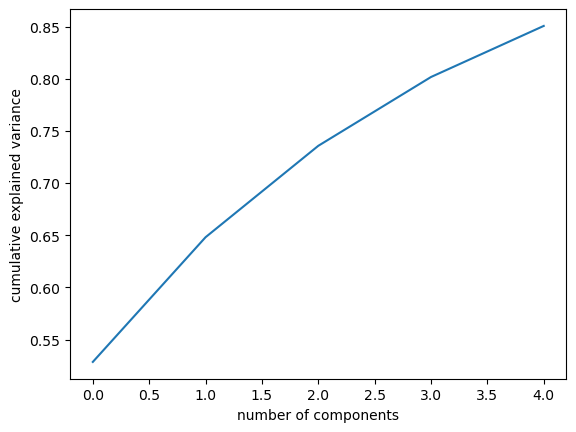

In [172]:
# PCA
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

from sklearn.decomposition import PCA

pca = PCA(n_components=5)

pca.fit(data_scaled)

pca.explained_variance_ratio_

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')




In [175]:
pca.components_[0]

array([ 0.33329385,  0.35636442,  0.34382938, -0.2079424 , -0.23719772,
        0.2409504 ,  0.28016235,  0.30367286, -0.32722082, -0.16663383,
       -0.20672592,  0.25483052, -0.27003412])

In [176]:
pca.components_[1]

array([-0.05688635, -0.12150982, -0.1126229 , -0.41323054, -0.54285669,
        0.48527685, -0.23020056, -0.0769047 ,  0.08576759,  0.12791645,
        0.42999845, -0.02754833, -0.00927317])

In [177]:
# print the importance of each feature for the first two components
for i in range(2):
    print(params)
    print(pca.components_[i])

['BuAre_sum', 'BuVol_3D_sum', 'BuEWA_3D_sum', 'BuIBD', 'BuAdj', 'BuSWR_3D_median', 'BuHt_wmean', 'StrHW_median', 'SVF_3D_mean', 'BuSqC_wmean', 'BuFra_3D_wmean', 'StrClo400_median']
[ 0.33329385  0.35636442  0.34382938 -0.2079424  -0.23719772  0.2409504
  0.28016235  0.30367286 -0.32722082 -0.16663383 -0.20672592  0.25483052
 -0.27003412]
['BuAre_sum', 'BuVol_3D_sum', 'BuEWA_3D_sum', 'BuIBD', 'BuAdj', 'BuSWR_3D_median', 'BuHt_wmean', 'StrHW_median', 'SVF_3D_mean', 'BuSqC_wmean', 'BuFra_3D_wmean', 'StrClo400_median']
[-0.05688635 -0.12150982 -0.1126229  -0.41323054 -0.54285669  0.48527685
 -0.23020056 -0.0769047   0.08576759  0.12791645  0.42999845 -0.02754833
 -0.00927317]


In [178]:
df = pd.DataFrame(pca.components_, columns=params+['city_centre_distance'])

In [179]:
df

,BuAre_sum,BuVol_3D_sum,BuEWA_3D_sum,BuIBD,BuAdj,BuSWR_3D_median,BuHt_wmean,StrHW_median,SVF_3D_mean,BuSqC_wmean,BuFra_3D_wmean,StrClo400_median,city_centre_distance
0,0.333294,0.356364,0.343829,-0.207942,-0.237198,0.240950,0.280162,0.303673,-0.327221,-0.166634,-0.206726,0.254831,-0.270034
1,-0.056886,-0.121510,-0.112623,-0.413231,-0.542857,0.485277,-0.230201,-0.076905,0.085768,0.127916,0.429998,-0.027548,-0.009273
2,-0.348019,-0.156164,-0.268572,-0.116993,-0.114545,0.153810,0.476614,-0.037841,0.177584,0.246557,-0.472342,-0.194743,-0.387232
3,-0.059932,-0.057352,-0.002314,-0.175881,-0.058971,-0.076187,0.037451,-0.236562,0.240021,-0.882240,-0.004830,-0.175847,-0.169207
4,-0.224098,-0.145893,-0.259667,0.373203,-0.024138,0.196211,0.017025,0.230092,0.192893,-0.200279,0.083986,0.731728,-0.098368


In [183]:
# temperature against PC1 PC2 etc

pc = pca.transform(data_scaled)

df = pd.DataFrame(pc, columns=['PC1','PC2','PC3','PC4','PC5'])

In [192]:
df

,PC1,PC2,PC3,PC4,PC5,Temperature_diff_K
0,1.171559,-1.800031,-0.127672,-0.899475,0.693322,1.30
1,0.035351,-0.829542,0.497769,1.308993,0.871830,1.02
2,-0.168972,-0.725492,0.891049,1.182705,1.037453,1.02
3,1.895167,-1.024598,1.193676,-0.599850,-0.800388,0.81
4,0.945086,0.661309,0.638025,-0.240390,-0.636562,0.82
...,...,...,...,...,...,...
1383,0.763919,-1.552514,0.385129,-0.659360,0.236249,-0.75
1384,1.635111,-1.668326,0.119331,-1.232489,0.390690,-0.54
1385,1.120129,-1.443803,0.459439,-1.270014,0.737733,-0.44
1386,0.920334,-1.359639,0.311119,-0.952140,0.889846,-0.44


<Axes: xlabel='PC1', ylabel='Temperature_diff_K'>

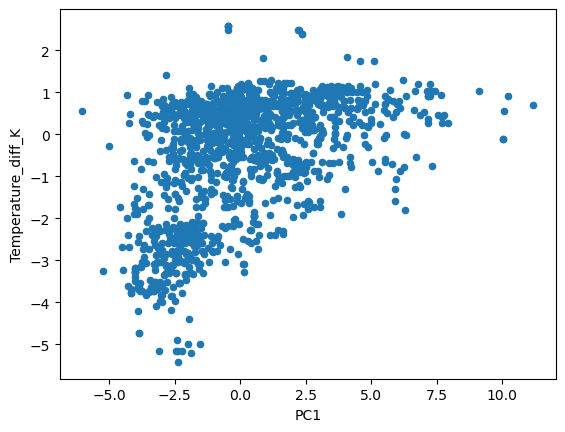

In [193]:
df.plot(x='PC1', y='Temperature_diff_K', kind='scatter')

# Only PC1 significant

<Axes: xlabel='PC2', ylabel='Temperature_diff_K'>

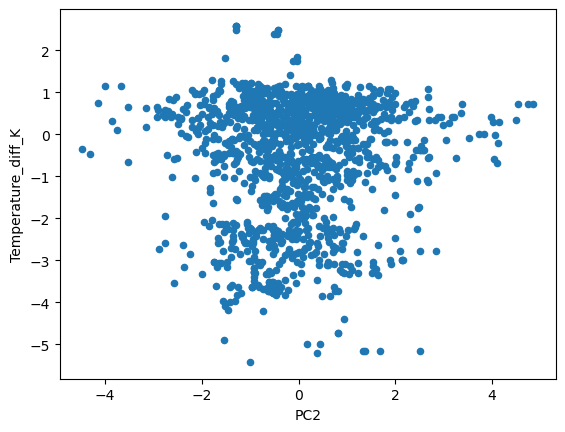

In [194]:
df.plot(x='PC2', y='Temperature_diff_K', kind='scatter')

<Axes: xlabel='PC3', ylabel='Temperature_diff_K'>

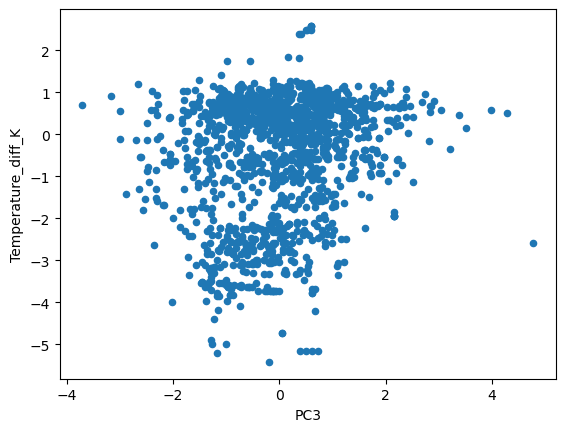

In [195]:
df.plot(x='PC3', y='Temperature_diff_K', kind='scatter')

<Axes: xlabel='PC4', ylabel='Temperature_diff_K'>

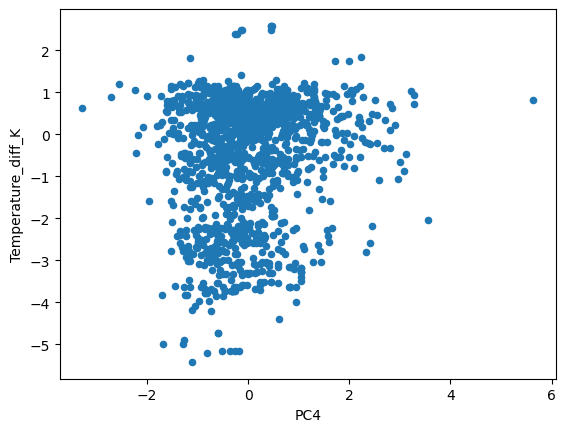

In [196]:
df.plot(x='PC4', y='Temperature_diff_K', kind='scatter')

<Axes: xlabel='PC5', ylabel='Temperature_diff_K'>

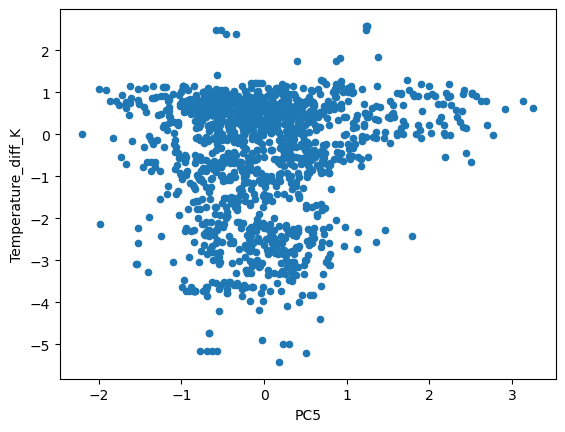

In [197]:
df.plot(x='PC5', y='Temperature_diff_K', kind='scatter')

In [225]:
# residual analysis removing city centre distance

# linear regression of 'Temperature_diff_K' and 'city_centre_distance'

X = sm.add_constant(data['city_centre_distance'])  # Add constant for regression
model = sm.OLS(data['Temperature_diff_K'], X).fit()

# Get the predicted values (fitted values)
y_pred = model.fittedvalues

# Calculate the residuals (errors)
residuals = data['Temperature_diff_K'] - y_pred


Text(0, 0.5, 'Temperature difference (K)')

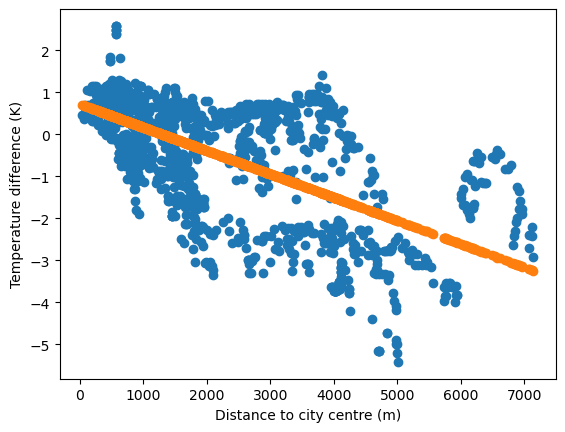

In [233]:
plt.scatter(data['city_centre_distance'],data['Temperature_diff_K'])
plt.scatter(data['city_centre_distance'],y_pred)
plt.xlabel('Distance to city centre (m)')
plt.ylabel('Temperature difference (K)')

In [ ]:
plt.plot

Text(0, 0.5, 'Residuals (K)')

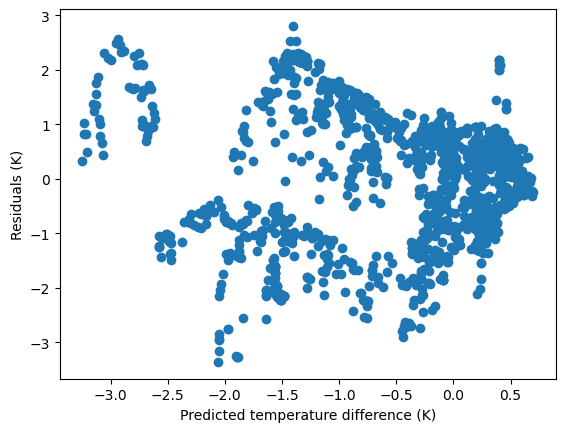

In [234]:
plt.scatter(y_pred,residuals)
plt.xlabel('Predicted temperature difference (K)')
plt.ylabel('Residuals (K)')

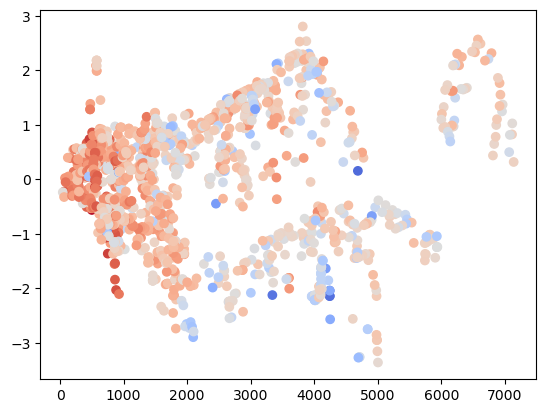

In [238]:
plt.scatter(data['city_centre_distance'],residuals,c=np.log(np.log(data['BuAre_sum'])),cmap='coolwarm')

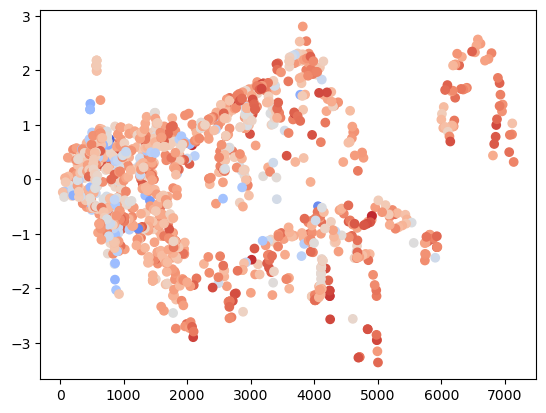

In [243]:
plt.scatter(data['city_centre_distance'],residuals,c=np.exp(data['BuSqC_wmean']),cmap='coolwarm')

In [261]:
data.sort_values('city_centre_distance',ascending=False).head(100)

,BuAre_sum,BuVol_3D_sum,BuEWA_3D_sum,BuIBD,BuAdj,BuSWR_3D_median,BuHt_wmean,StrHW_median,SVF_3D_mean,BuSqC_wmean,BuFra_3D_wmean,StrClo400_median,city_centre_distance,Temperature_diff_K,geometry
1179,1301.541714,10069.943110,5111.659007,13.291637,0.793333,0.033416,7.760221,0.258710,0.820344,0.894078,0.293313,0.000006,7140.130583,-2.93,POINT (4187812.822 5332894.775)
1181,1068.924310,8166.651241,4426.865372,14.373510,0.666667,0.214209,7.663228,0.255489,0.769170,0.797875,0.302656,0.000006,7118.087510,-2.21,POINT (4187736.745 5332846.967)
1180,1365.533835,10557.827818,5260.940434,10.550264,0.666667,0.014130,7.754892,0.222752,0.763441,0.886170,0.291431,0.000006,7114.484676,-2.41,POINT (4187782.041 5332857.988)
1182,990.381498,8137.444945,3811.452097,15.921988,0.700000,0.188291,8.241078,0.384334,0.785388,0.898510,0.293175,0.000006,7079.851890,-2.40,POINT (4187672.068 5332784.825)
1183,852.536285,7033.240564,3250.375646,15.921988,0.700000,0.188240,8.274490,0.317369,0.835238,0.915615,0.290807,0.000005,7069.495705,-2.71,POINT (4187653.177 5332767.348)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4189,1776.584879,16609.582500,6642.732128,16.710077,0.820000,0.018212,9.376474,0.340053,0.780414,0.880431,0.270691,0.000014,4926.708823,-3.77,POINT (4194553.203 5324278.252)
828,729.050459,5286.111674,2750.952011,20.452594,0.833333,0.000000,7.272064,0.211509,0.853673,0.927201,0.292182,0.000012,4912.661562,-2.68,POINT (4194284.802 5323737.717)
829,374.933340,2632.166810,1470.818540,16.635930,0.750000,0.000000,7.040962,0.202101,0.871353,0.982829,0.294790,0.000011,4905.059167,-2.68,POINT (4194290.891 5323764.928)
765,1001.290317,8556.107586,4142.628628,15.744152,0.767347,0.000000,8.569982,0.342057,0.762014,0.868389,0.286364,0.000013,4904.141345,-2.75,POINT (4194231.385 5323659.406)


In [265]:
data.sort_values('city_centre_distance',ascending=False).head(500).explore()

In [266]:
data['residuals'] = residuals

In [267]:
data

,BuAre_sum,BuVol_3D_sum,BuEWA_3D_sum,BuIBD,BuAdj,BuSWR_3D_median,BuHt_wmean,StrHW_median,SVF_3D_mean,BuSqC_wmean,BuFra_3D_wmean,StrClo400_median,city_centre_distance,Temperature_diff_K,geometry,residuals
0,2045.137502,27573.514160,9535.040396,15.489008,0.801020,0.088512,13.522859,1.084105,0.614575,0.834154,0.258958,0.000019,623.768885,1.30,POINT (4190036.817 5325468.375),0.926161
2,1434.517025,20644.486074,7186.388115,14.259553,0.706667,0.163917,14.433956,0.457891,0.772123,0.700344,0.264519,0.000015,734.668396,1.02,POINT (4190032.428 5325356.571),0.707783
3,1196.349353,17946.472724,5959.129088,14.259553,0.706667,0.180731,15.045517,0.457891,0.781607,0.717530,0.263292,0.000015,737.820225,1.02,POINT (4190033.535 5325353.501),0.709534
6,2627.900383,43797.002203,8722.270451,12.887429,0.600000,0.240001,16.715994,0.578977,0.617399,0.860527,0.239288,0.000010,879.289077,0.81,POINT (4189874.872 5325214.686),0.578142
7,2052.922158,28179.773482,8662.014642,10.858990,0.530032,0.303973,13.767789,0.672167,0.668126,0.845252,0.270161,0.000006,927.859016,0.82,POINT (4189835.829 5325170.751),0.615130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5936,1956.055714,27779.508752,8765.103093,14.274976,0.835714,0.137593,14.244175,0.484346,0.601913,0.853686,0.253036,0.000019,649.430093,-0.75,POINT (4190049.871 5325444.036),-1.109580
5937,2250.276178,32075.815949,10226.520380,13.859627,0.806122,0.130471,14.296700,1.084105,0.605865,0.868644,0.253879,0.000019,640.404053,-0.54,POINT (4190050.139 5325453.163),-0.904596
5938,1816.300415,26003.079868,8465.846513,14.445443,0.780612,0.134236,14.359229,1.084105,0.624714,0.879611,0.256419,0.000019,626.003491,-0.44,POINT (4190050.024 5325467.662),-0.812597
5939,1720.557210,23596.315115,8064.489737,14.445443,0.780612,0.126705,13.755436,1.084105,0.637627,0.850390,0.259638,0.000019,616.909386,-0.44,POINT (4190046.152 5325476.344),-0.817651


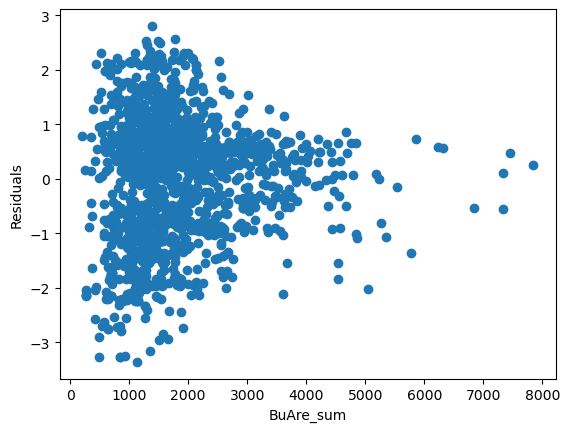

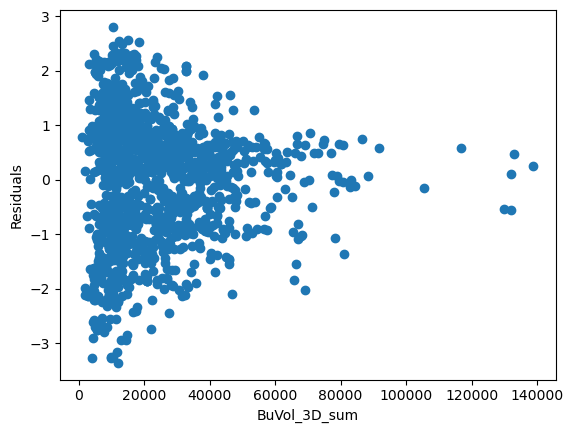

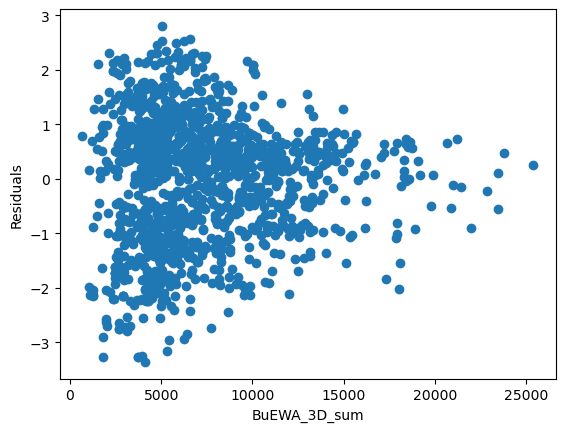

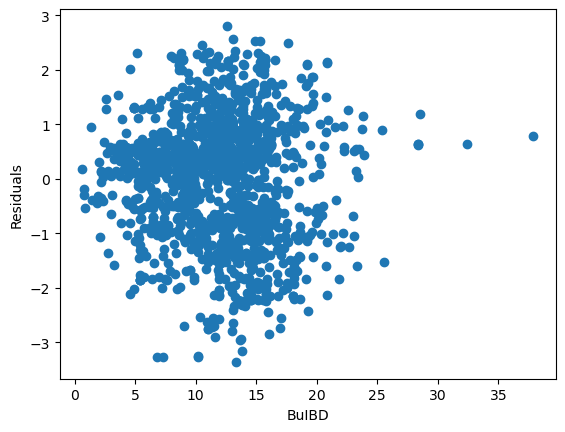

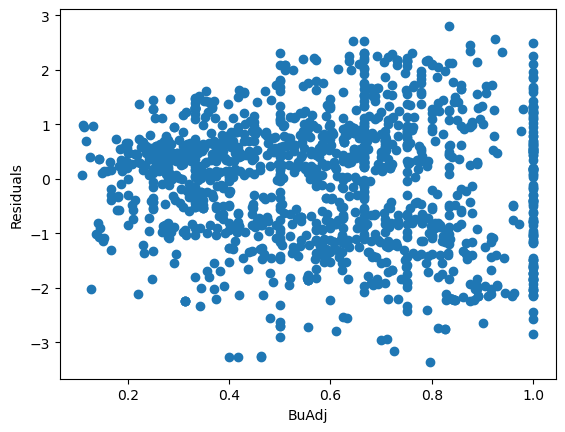

...

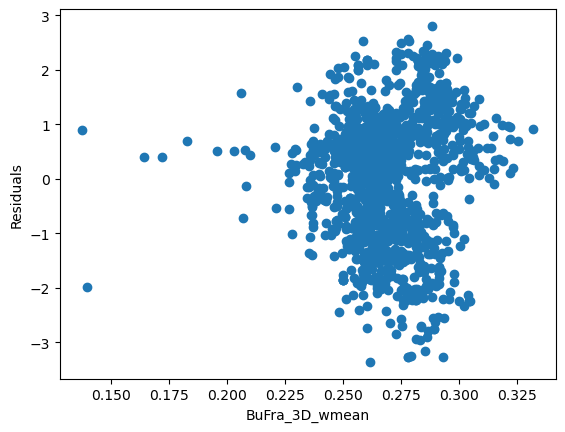

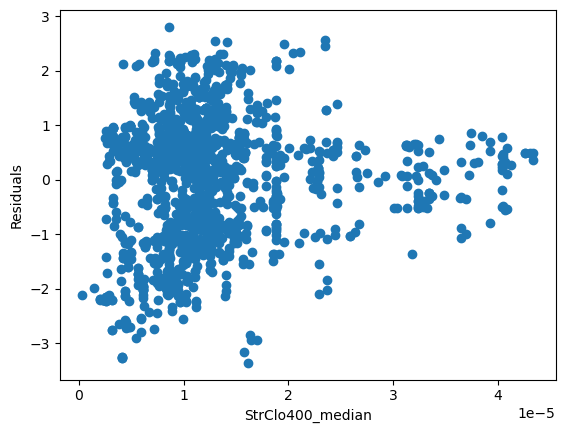

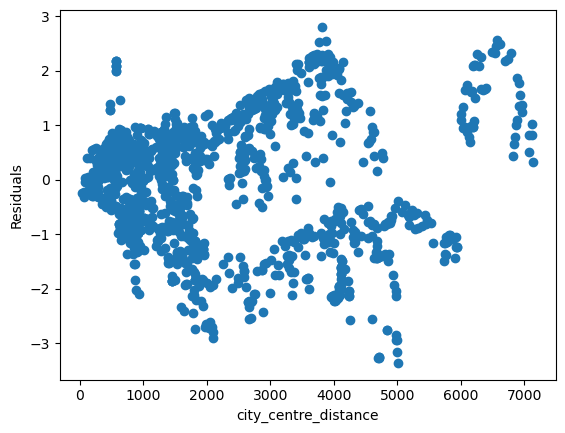

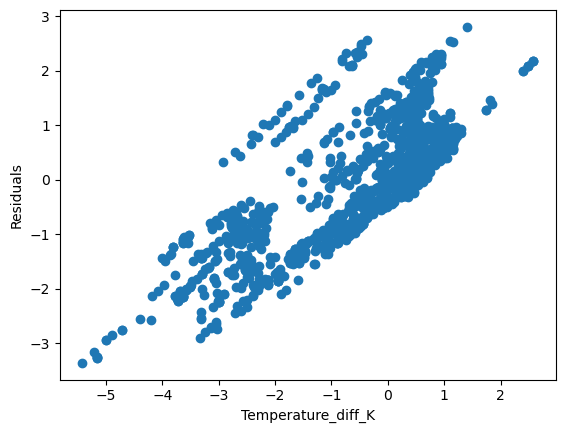

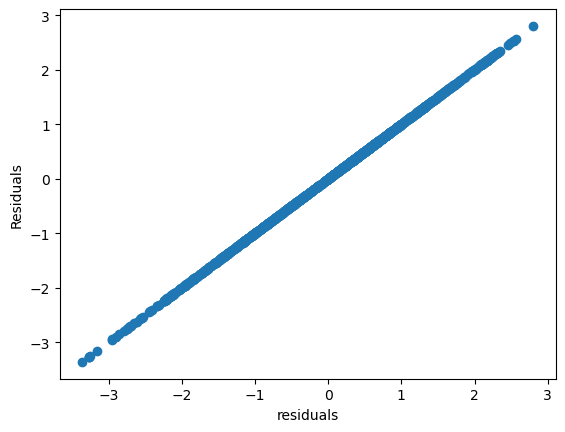

In [212]:
# plot each column in data against residuals
data['residuals'] = residuals
for i in data.columns:
    plt.scatter(data[i], residuals)
    plt.xlabel(i)
    plt.ylabel('Residuals')
    plt.show()

In [213]:
params

['BuAre_sum',
 'BuVol_3D_sum',
 'BuEWA_3D_sum',
 'BuIBD',
 'BuAdj',
 'BuSWR_3D_median',
 'BuHt_wmean',
 'StrHW_median',
 'SVF_3D_mean',
 'BuSqC_wmean',
 'BuFra_3D_wmean',
 'StrClo400_median']

In [214]:
X_new = sm.add_constant(data[params])  # Include other factors
model_res = sm.OLS(residuals, X_new).fit()
print(model_res.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.042
Model:                            OLS   Adj. R-squared:                  0.034
Method:                 Least Squares   F-statistic:                     5.037
Date:                Tue, 18 Mar 2025   Prob (F-statistic):           2.94e-08
Time:                        18:13:16   Log-Likelihood:                -2126.1
No. Observations:                1388   AIC:                             4278.
Df Residuals:                    1375   BIC:                             4346.
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -1.1827      1.340  

In [216]:
# linear model summary 
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     Temperature_diff_K   R-squared:                       0.387
Model:                            OLS   Adj. R-squared:                  0.386
Method:                 Least Squares   F-statistic:                     874.4
Date:                Tue, 18 Mar 2025   Prob (F-statistic):          2.12e-149
Time:                        18:26:35   Log-Likelihood:                -2156.0
No. Observations:                1388   AIC:                             4316.
Df Residuals:                    1386   BIC:                             4326.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.7204      0.052     13.957      0.000       0.619       0.822
city_centre_distance    -0.0006   1.88e-05    -29.571      0.000      -0.001      -0.001
==============================================================================
Omnibus:                       32.628   Durbin-Watson:                   0.093
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               29.364
Skew:                          -0.302   Prob(JB):                     4.20e-07
Kurtosis:                       2.621   Cond. No.                     4.62e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.62e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [217]:
import numpy as np
import statsmodels.api as sm

# Create polynomial terms
data['x2'] = data['city_centre_distance']**2
data['x3'] = data['city_centre_distance']**3

# Fit quadratic model
X_quad = sm.add_constant(data[['city_centre_distance', 'x2']])
model_quad = sm.OLS(data['Temperature_diff_K'], X_quad).fit()
print(model_quad.summary())

# Get the predicted values (fitted values)
y_pred_quad = model_quad.fittedvalues
# Calculate the residuals (errors)
residuals_quad = data['Temperature_diff_K'] - y_pred_quad

# Fit cubic model
X_cubic = sm.add_constant(data[['city_centre_distance', 'x2', 'x3']])
model_cubic = sm.OLS(data['Temperature_diff_K'], X_cubic).fit()
print(model_cubic.summary())

# Get the predicted values (fitted values)
y_pred_cubic = model_cubic.fittedvalues
# Calculate the residuals (errors)
residuals_cubic = data['Temperature_diff_K'] - y_pred_cubic


                            OLS Regression Results                            
Dep. Variable:     Temperature_diff_K   R-squared:                       0.395
Model:                            OLS   Adj. R-squared:                  0.395
Method:                 Least Squares   F-statistic:                     452.9
Date:                Tue, 18 Mar 2025   Prob (F-statistic):          4.53e-152
Time:                        18:28:16   Log-Likelihood:                -2146.2
No. Observations:                1388   AIC:                             4298.
Df Residuals:                    1385   BIC:                             4314.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.9695 

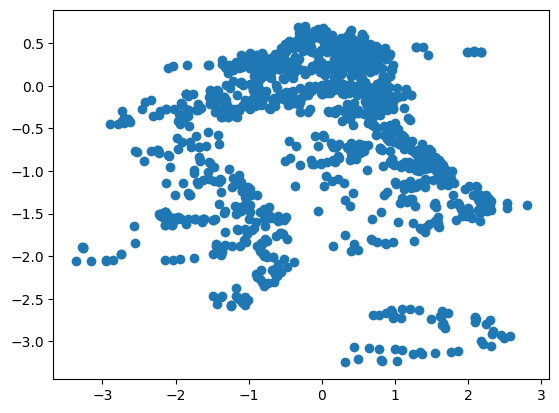

In [224]:
plt.scatter(residuals,y_pred)

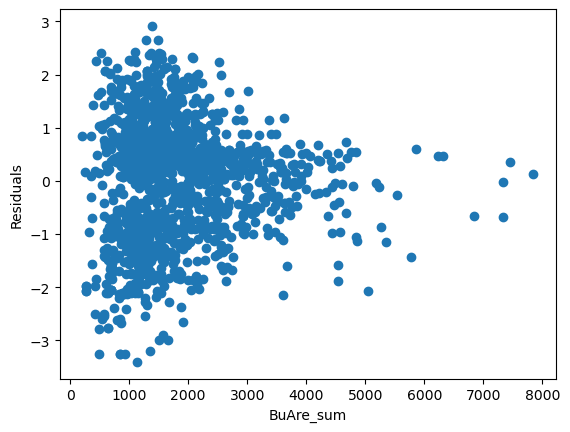

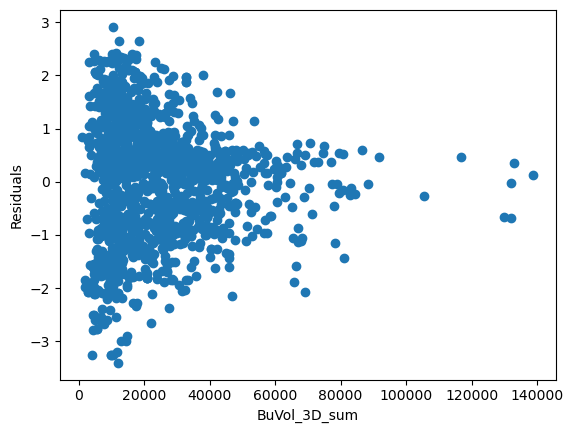

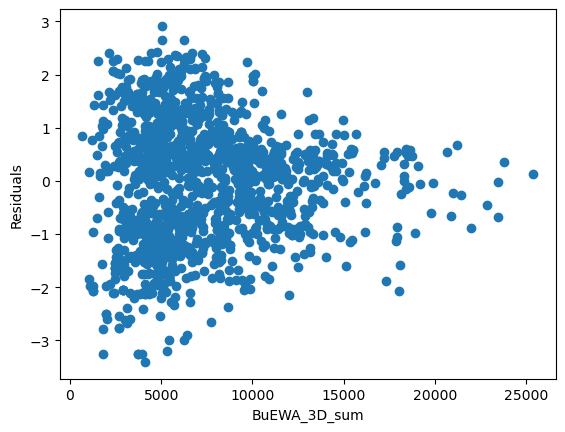

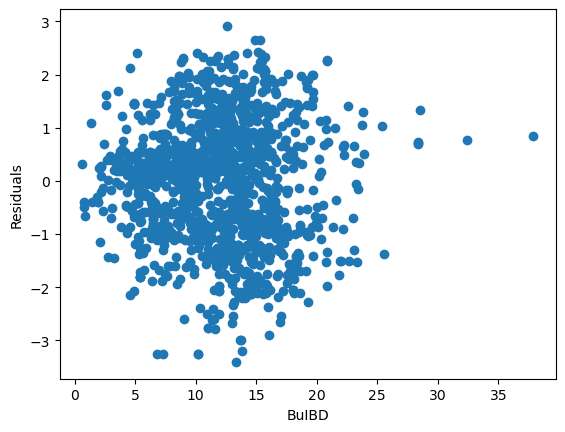

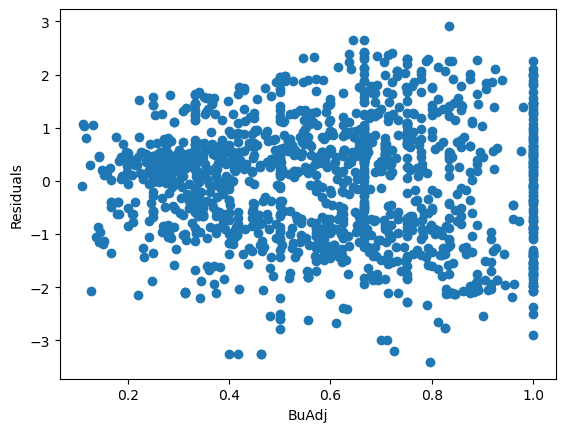

...

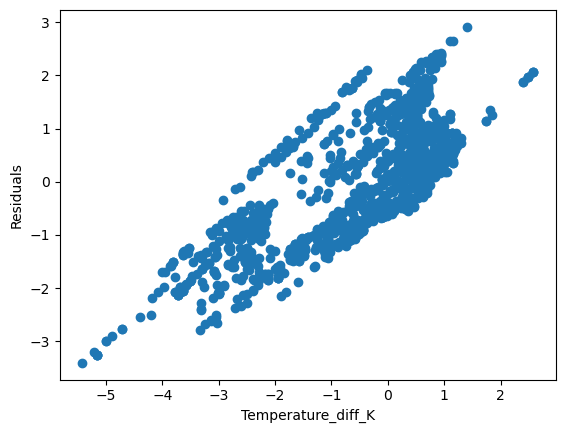

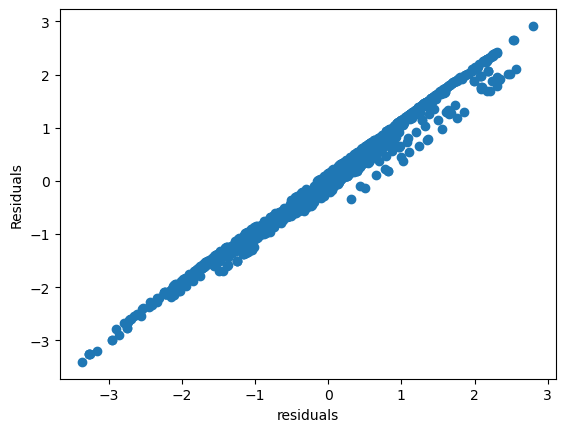

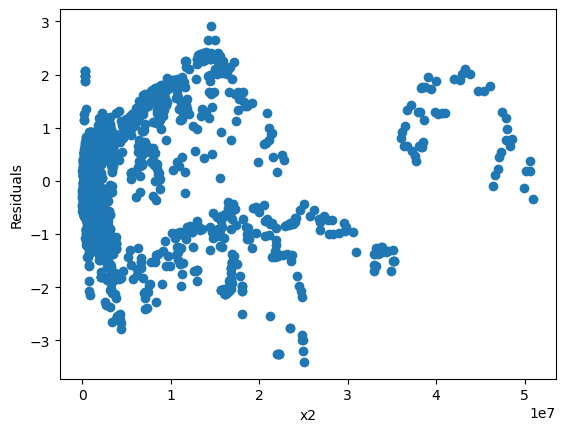

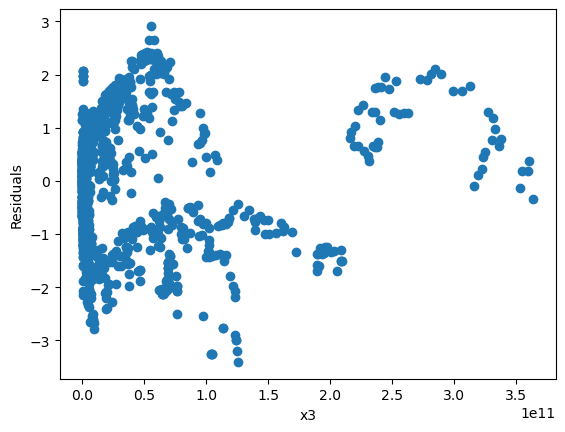

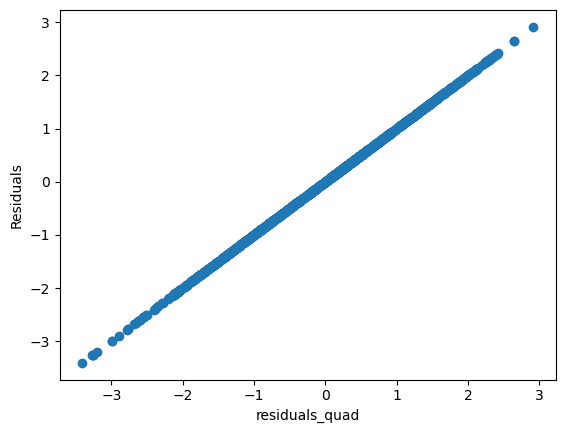

In [218]:
# plot each column in data against residuals
data['residuals_quad'] = residuals_quad
for i in data.columns:
    plt.scatter(data[i], residuals_quad)
    plt.xlabel(i)
    plt.ylabel('Residuals')
    plt.show()

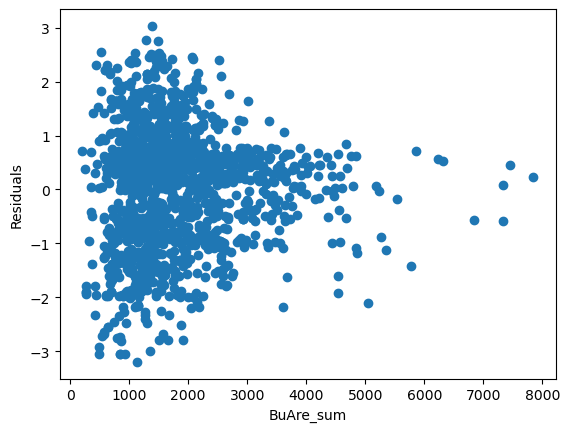

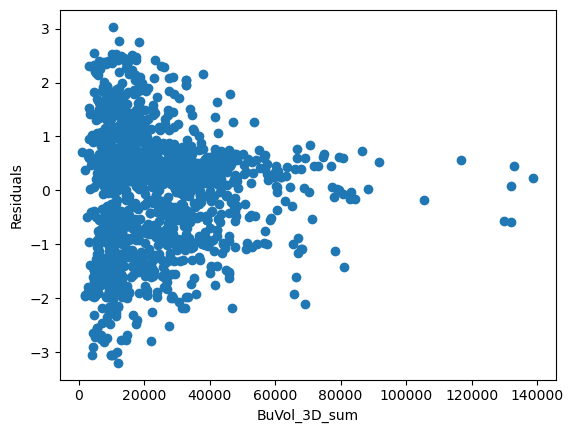

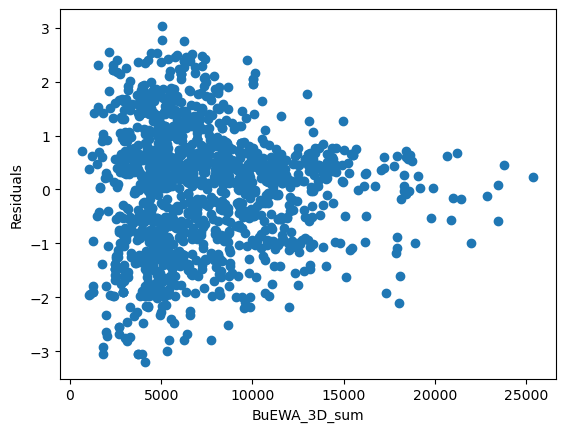

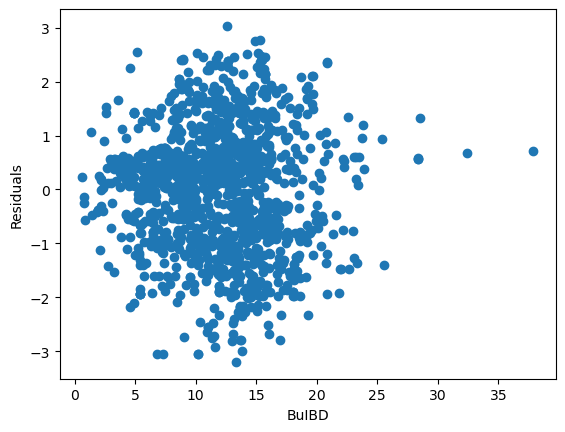

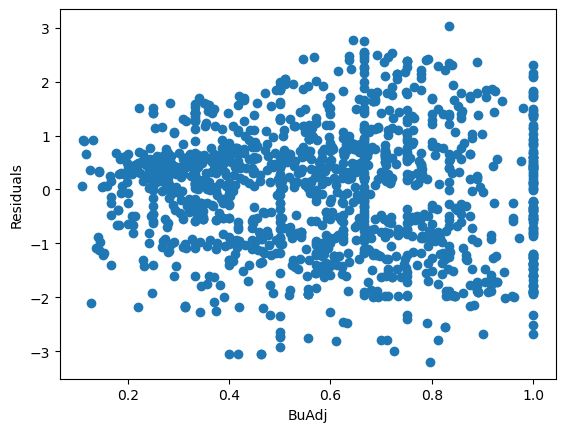

...

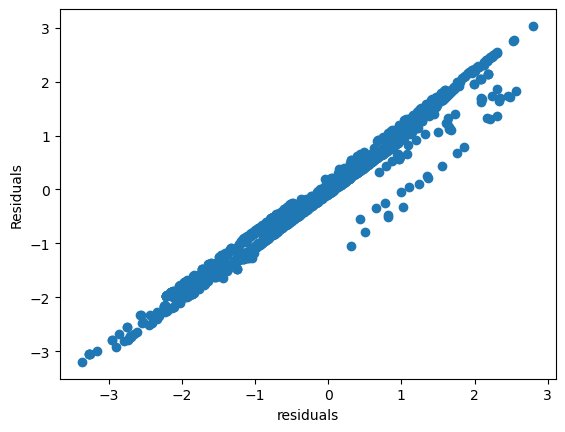

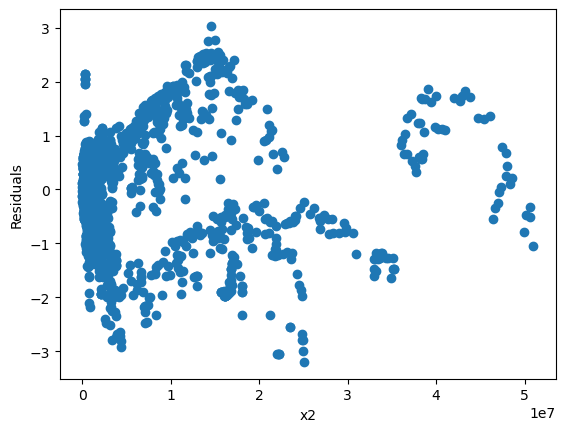

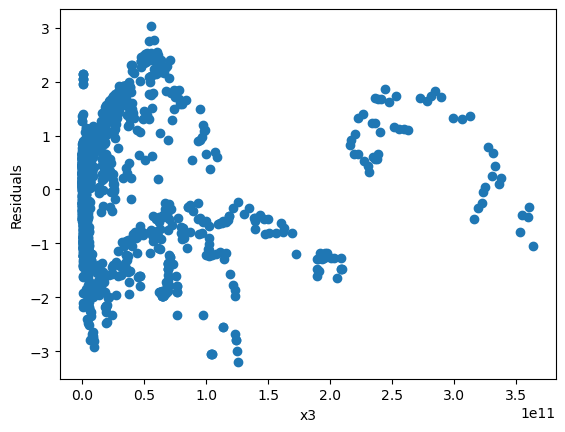

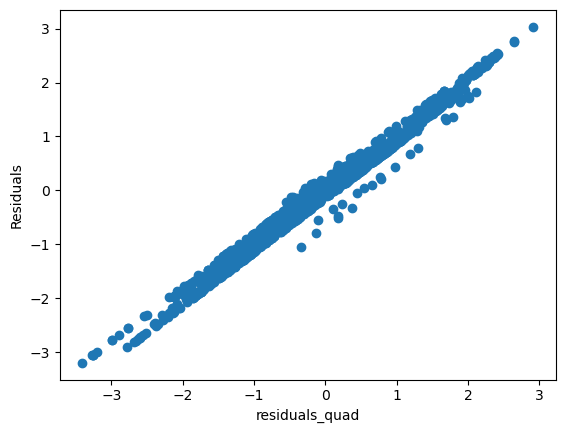

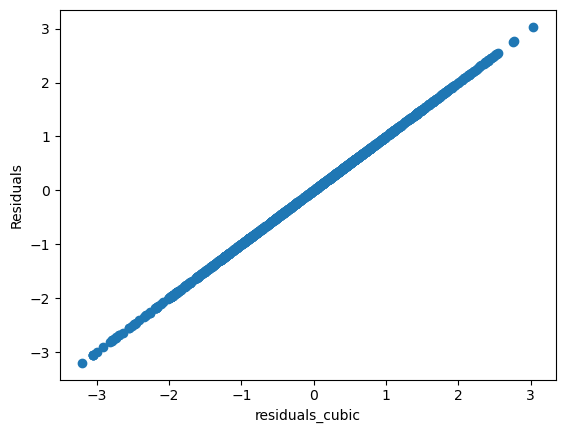

In [219]:
# plot each column in data against residuals
data['residuals_cubic'] = residuals_cubic
for i in data.columns:
    plt.scatter(data[i], residuals_cubic)
    plt.xlabel(i)
    plt.ylabel('Residuals')
    plt.show()

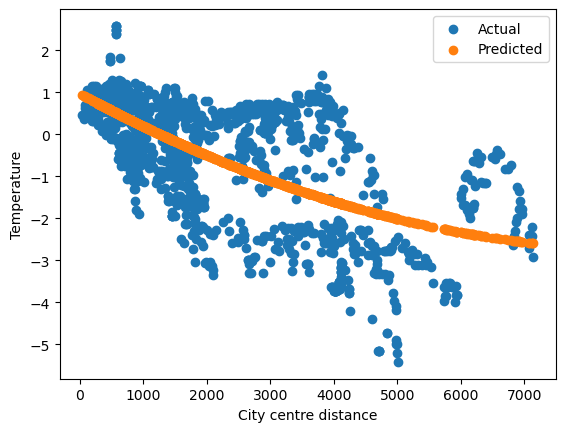

In [220]:
# plot y actual and y pred on same axis
plt.scatter(data['city_centre_distance'], data['Temperature_diff_K'], label='Actual')
plt.scatter(data['city_centre_distance'], y_pred_quad, label='Predicted')
plt.xlabel('City centre distance')
plt.ylabel('Temperature')
plt.legend()

In [ ]:
X_new = sm.add_constant(data[params])  # Include other factors
model_res = sm.OLS(residuals, X_new).fit()
print(model_res.summary())